# Self-Driving Car Engineer Nanodegree

## Deep Learning

## Project: Build a Traffic Sign Recognition Classifier

In this notebook, a template is provided for you to implement your functionality in stages which is required to successfully complete this project. If additional code is required that cannot be included in the notebook, be sure that the Python code is successfully imported and included in your submission, if necessary. Sections that begin with **'Implementation'** in the header indicate where you should begin your implementation for your project. Note that some sections of implementation are optional, and will be marked with **'Optional'** in the header.

In addition to implementing code, there will be questions that you must answer which relate to the project and your implementation. Each section where you will answer a question is preceded by a **'Question'** header. Carefully read each question and provide thorough answers in the following text boxes that begin with **'Answer:'**. Your project submission will be evaluated based on your answers to each of the questions and the implementation you provide.

>**Note:** Code and Markdown cells can be executed using the **Shift + Enter** keyboard shortcut. In addition, Markdown cells can be edited by typically double-clicking the cell to enter edit mode.

---

## Step 1: Dataset Exploration

Visualize the German Traffic Signs Dataset. This is open ended, some suggestions include: plotting traffic signs images, plotting the count of each sign, etc. Be creative!


The pickled data is a dictionary with 4 key/value pairs:

- features -> the images pixel values, (width, height, channels)
- labels -> the label of the traffic sign
- sizes -> the original width and height of the image, (width, height)
- coords -> coordinates of a bounding box around the sign in the image, (x1, y1, x2, y2)

In [6]:
# Load pickled data
import pickle
import numpy as np

# TODO: fill this in based on where you saved the training and testing data
training_file = 'train.p'
testing_file = 'test.p'

with open(training_file, mode='rb') as f:
    train = pickle.load(f)
with open(testing_file, mode='rb') as f:
    test = pickle.load(f)
    
X_train, y_train = np.copy(train['features']), np.copy(train['labels'])
X_test, y_test = np.copy(test['features']), np.copy(test['labels'])

# Set flags for feature engineering.  This will prevent you from skipping an important steps.
is_features_yuv = False
is_features_y_normal = False
is_labels_encod = False
is_labels_float32 = False
has_new_jittered_datasets = False
has_split_jittered_datasets = False
has_pickled_split_datasets = False

print("Traffic sign datasets loaded")

Traffic sign datasets loaded


In [7]:
### To start off let's do a basic data summary.
# TODO: number of training examples
n_train = len(X_train)

# TODO: number of testing examples
n_test = len(X_test)

# TODO: what's the shape of an image?
image_shape = X_train[0].shape

# TODO: how many classes are in the dataset
classes = {}
for labelinTraining in y_train:
    classes[labelinTraining] = classes.get(labelinTraining, 0) + 1
n_classes = len(list(classes))

print("Number of training samples =", n_train)
print("Number of testing samples =", n_test)
print("Image data shape =", image_shape)
print("Number of classes =", n_classes)

Number of training samples = 39209
Number of testing samples = 12630
Image data shape = (32, 32, 3)
Number of classes = 43


In [8]:
#importing some useful packages for plotting and visualization
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import matplotlib.image as mpimg
import cv2
%matplotlib inline

#import sklearn functions for preprocessing
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelBinarizer

#import utilities for showing progress
import time
import math
from tqdm import tqdm

#import pandas for csv file import
#NOTE: install pandas in your environment!
#conda install pandas
import pandas as pd

#random function
import random

#os function for saving models
import os
import re

print("imported useful packages")

imported useful packages


In [9]:
### Data exploration visualization goes here.
### Feel free to use as many code cells as needed.

# get the label description from the CSV file.
classLabelList = pd.read_csv('signnames.csv')

# Analyze Max and Min sizes (number of pixels) of the original image
def datasetsizes_info(datasettxt, dataset):
    print(datasettxt, " Original Size Stats")
    print("                  X             Y")
    sizeStats = pd.DataFrame(dataset['sizes'])
    print(sizeStats.describe())
    originalSizes = {}
    modeCount = 0
    modeSize = 0
    for i in range(len(dataset['sizes'])):
        # for each size
        sizes = dataset['sizes'][i]
    
        # create a pixel hash
        numpixelsStr = str(int(sizes[0])*int(sizes[1]))
    
        # try to see if there is a hash hit
        sizeInstance = originalSizes.get(numpixelsStr, {'count': 0, 'samples':[]})
    
        # add to the count
        count = sizeInstance['count'] + 1
        
        # add to samples of this class
        samples = sizeInstance['samples']
        samples.append(i)
    
        # put in the last Index
        originalSizes[numpixelsStr] = {'lastIdx':i, 'count': count, 'size':sizes, 'samples':samples}
    
        # update most common size
        if count > modeCount:
            modeCount = count
            modeSize = int(numpixelsStr)
    
    # get the list of sizes and sort them
    sortedSizes = np.array(list(originalSizes.keys()), np.int32)
    sortedSizes.sort()

    # get the unique number of original picture sizes and the min and max last instance
    n_sizes = len(sortedSizes)
    minSize = sortedSizes[0]
    maxSize = sortedSizes[n_sizes-1]

    # print the stats
    print("\nNumber of unique original sizes in ", datasettxt, " set: ", n_sizes, "\n")
    return n_sizes, originalSizes, minSize, maxSize, modeSize

train_sizes, train_originalSizes, train_minSize, train_maxSize, train_modeSize = datasetsizes_info("training", train)
test_sizes, test_originalSizes, test_minSize, test_maxSize, test_modeSize = datasetsizes_info("testing", test)


training  Original Size Stats
                  X             Y
                  0             1
count  39209.000000  39209.000000
mean      50.835880     50.328930
std       24.306933     23.115423
min       25.000000     25.000000
25%       35.000000     35.000000
50%       43.000000     43.000000
75%       58.000000     58.000000
max      243.000000    225.000000

Number of unique original sizes in  training  set:  2034 

testing  Original Size Stats
                  X             Y
                  0             1
count  12630.000000  12630.000000
mean      50.446952     50.364450
std       24.886837     23.698908
min        2.000000     25.000000
25%       34.000000     35.000000
50%       43.000000     43.000000
75%       58.000000     57.000000
max      253.000000    232.000000

Number of unique original sizes in  testing  set:  1362 



  Minimum Original Size Samples:


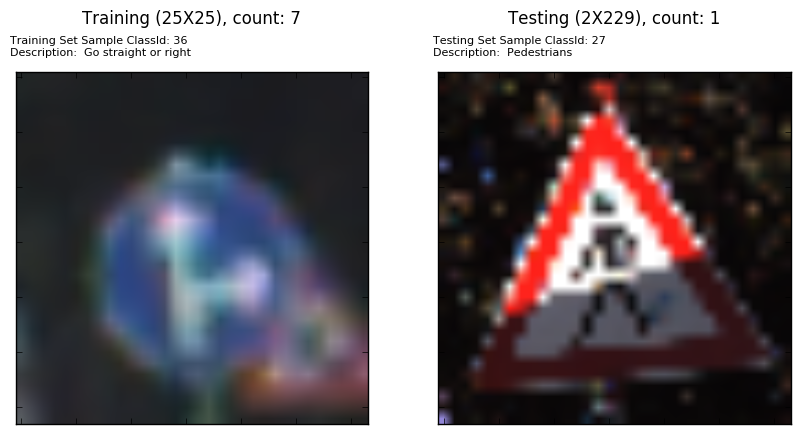

In [10]:
### Data exploration visualization goes here.
### Feel free to use as many code cells as needed.

# draw the min size pictures from both train and test
train_size = train_originalSizes[str(train_minSize)]['size']
train_count = train_originalSizes[str(train_minSize)]['count']
train_index = train_originalSizes[str(train_minSize)]['lastIdx']
train_classId = train['labels'][train_index]
train_description = classLabelList[classLabelList.ClassId==train_classId].SignName.to_string(header=False,index=False)

test_size = test_originalSizes[str(test_minSize)]['size']
test_count = test_originalSizes[str(test_minSize)]['count']
test_index = test_originalSizes[str(test_minSize)]['lastIdx']
test_classId = test['labels'][test_index]
test_description = classLabelList[classLabelList.ClassId==test_classId].SignName.to_string(header=False,index=False)

# draw the min size picture for training and testing
print("  Minimum Original Size Samples:")
fg, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 10))

ax1.imshow(X_train[train_index])
ax1.set_title('Training (%dX%d), count: %d\n\n'%(train_size[0], train_size[1], train_count))
ax1.text(-1.0,-2.0,'Training Set Sample ClassId: %d\nDescription:  %s'%(train_classId, train_description), fontsize=8)

ax2.imshow(X_test[test_index])
ax2.set_title('Testing (%dX%d), count: %d\n\n'%(test_size[0], test_size[1], test_count))
ax2.text(-1.0,-2.0,'Testing Set Sample ClassId: %d\nDescription:  %s'%(test_classId, test_description), fontsize=8)

plt.setp([a.get_xticklabels() for a in fg.axes], visible=False)
plt.setp([a.get_yticklabels() for a in fg.axes], visible=False)

plt.show()

  Maximum Original Size Samples:


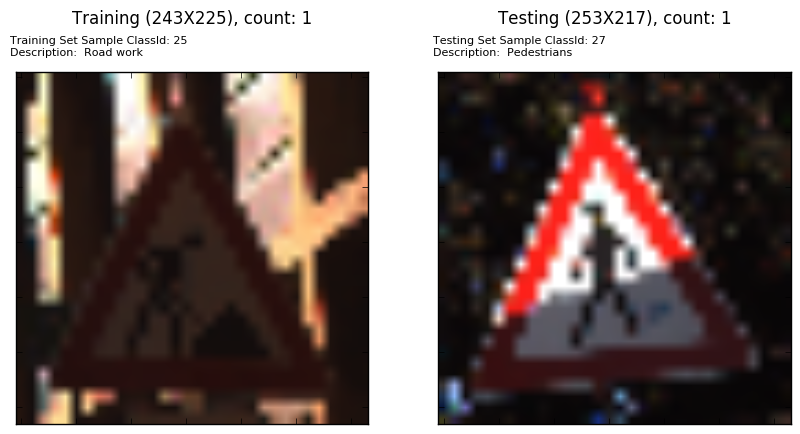

In [11]:
### Data exploration visualization goes here.
### Feel free to use as many code cells as needed.

# draw the max size pictures from both train and test
train_size = train_originalSizes[str(train_maxSize)]['size']
train_count = train_originalSizes[str(train_maxSize)]['count']
train_index = train_originalSizes[str(train_maxSize)]['lastIdx']
train_classId = train['labels'][train_index]
train_description = classLabelList[classLabelList.ClassId==train_classId].SignName.to_string(header=False,index=False)

test_size = test_originalSizes[str(test_maxSize)]['size']
test_count = test_originalSizes[str(test_maxSize)]['count']
test_index = test_originalSizes[str(test_maxSize)]['lastIdx']
test_classId = test['labels'][test_index]
test_description = classLabelList[classLabelList.ClassId==test_classId].SignName.to_string(header=False,index=False)

# draw the max size picture for training and testing
print("  Maximum Original Size Samples:")
fg, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 10))

ax1.imshow(X_train[train_index])
ax1.set_title('Training (%dX%d), count: %d\n\n'%(train_size[0], train_size[1], train_count))
ax1.text(-1.0,-2.0,'Training Set Sample ClassId: %d\nDescription:  %s'%(train_classId, train_description), fontsize=8)

ax2.imshow(X_test[test_index])
ax2.set_title('Testing (%dX%d), count: %d\n\n'%(test_size[0], test_size[1], test_count))
ax2.text(-1.0,-2.0,'Testing Set Sample ClassId: %d\nDescription:  %s'%(test_classId, test_description), fontsize=8)

plt.setp([a.get_xticklabels() for a in fg.axes], visible=False)
plt.setp([a.get_yticklabels() for a in fg.axes], visible=False)

plt.show()

  Highest Count Original Size Samples:


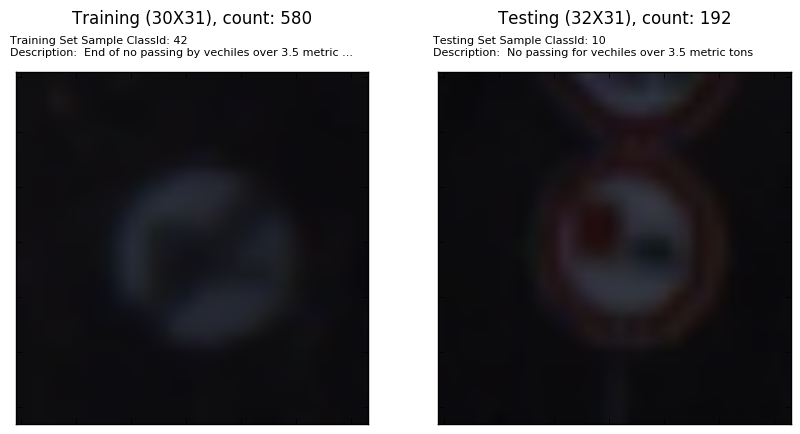

In [12]:
### Data exploration visualization goes here.
### Feel free to use as many code cells as needed.

# draw the mode size pictures from both train and test
train_size = train_originalSizes[str(train_modeSize)]['size']
train_count = train_originalSizes[str(train_modeSize)]['count']
train_index = train_originalSizes[str(train_modeSize)]['lastIdx']
train_classId = train['labels'][train_index]
train_description = classLabelList[classLabelList.ClassId==train_classId].SignName.to_string(header=False,index=False)

test_size = test_originalSizes[str(test_modeSize)]['size']
test_count = test_originalSizes[str(test_modeSize)]['count']
test_index = test_originalSizes[str(test_modeSize)]['lastIdx']
test_classId = test['labels'][test_index]
test_description = classLabelList[classLabelList.ClassId==test_classId].SignName.to_string(header=False,index=False)

# draw the mode size picture for training and testing
print("  Highest Count Original Size Samples:")
fg, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 10))

ax1.imshow(X_train[train_index])
ax1.set_title('Training (%dX%d), count: %d\n\n'%(train_size[0], train_size[1], train_count))
ax1.text(-1.0,-2.0,'Training Set Sample ClassId: %d\nDescription:  %s'%(train_classId, train_description), fontsize=8)

ax2.imshow(X_test[test_index])
ax2.set_title('Testing (%dX%d), count: %d\n\n'%(test_size[0], test_size[1], test_count))
ax2.text(-1.0,-2.0,'Testing Set Sample ClassId: %d\nDescription:  %s'%(test_classId, test_description), fontsize=8)

plt.setp([a.get_xticklabels() for a in fg.axes], visible=False)
plt.setp([a.get_yticklabels() for a in fg.axes], visible=False)

plt.show()

In [13]:
### Data exploration visualization goes here.
### Feel free to use as many code cells as needed.

def labelset_info(labelsettxt, dataset):
    # get stats for the labels
    labelset = dataset['labels']
    labelStats = pd.DataFrame(labelset)
   
    print(labelsettxt, "set label stats:")
    print(labelStats.describe())
   
    labelsInfo = {}
    modeCount = 0
    modeLabel = 0
    for i in range(len(labelset)):
        # for each label
        label = str(labelset[i])
      
        # try to see if there is a hash hit
        labelInstance = labelsInfo.get(label, {'count': 0, 'samples':[]})
      
        # add to the count
        count = labelInstance['count'] + 1
      
        # add to samples
        samples = labelInstance['samples']
        samples.append(i)
    
      # put in the last Index
        labelsInfo[label] = {'lastIdx':i, 'count': count, 'label':int(label), 'samples':samples}
      
        # update most common size
        if count > modeCount:
            modeCount = count 
            modeSize = labelsInfo[label]
    
    # get the list of counts and sort them
    sortedLabels = list(labelsInfo.keys())
   
    def compare_count(label):
        return labelsInfo[label]['count']
   
    sortedLabels.sort(key=compare_count)

    # get the unique number of original picture sizes and the min and max last instance
    n_labels = len(sortedLabels)
    minLabel = sortedLabels[0]
    maxLabel = sortedLabels[n_labels-1]

    # print the stats
    print("\nNumber of unique labels in", labelsettxt,"set: ", n_labels)

    print("\nDistribution of", labelsettxt, "set labels:")
    for n in range(n_labels):
        i = sortedLabels[n_labels-n-1]
        classId = labelsInfo[str(i)]['label']
        index = labelsInfo[str(i)]['lastIdx']
        count = labelsInfo[str(i)]['count']
        description = classLabelList[classLabelList.ClassId==classId].SignName.to_string(header=False,index=False)
        print(labelsettxt, " set count: {0:4d}  ClassId: {1:02d}  Description: {2}".format(count, classId, description))

    return n_labels, sortedLabels, labelsInfo, minLabel, maxLabel, modeLabel

train_labels, train_sortedLabels, train_labelInfo, train_minLabel, train_maxLabel, train_modeLabel = labelset_info("training", train)
test_labels, test_sortedLabels, test_labelInfo, test_minLabel, test_maxLabel, test_modeLabel = labelset_info("testing", test)


training set label stats:
                  0
count  39209.000000
mean      15.788390
std       12.013238
min        0.000000
25%        5.000000
50%       12.000000
75%       25.000000
max       42.000000

Number of unique labels in training set:  43

Distribution of training set labels:
training  set count: 2250  ClassId: 02  Description: Speed limit (50km/h)
training  set count: 2220  ClassId: 01  Description: Speed limit (30km/h)
training  set count: 2160  ClassId: 13  Description: Yield
training  set count: 2100  ClassId: 12  Description: Priority road
training  set count: 2070  ClassId: 38  Description: Keep right
training  set count: 2010  ClassId: 10  Description: No passing for vechiles over 3.5 metric tons
training  set count: 1980  ClassId: 04  Description: Speed limit (70km/h)
training  set count: 1860  ClassId: 05  Description: Speed limit (80km/h)
training  set count: 1500  ClassId: 25  Description: Road work
training  set count: 1470  ClassId: 09  Description: No passing

Train set sample images (RGB): 100%|██████████| 43/43 [00:14<00:00,  3.24labels/s]


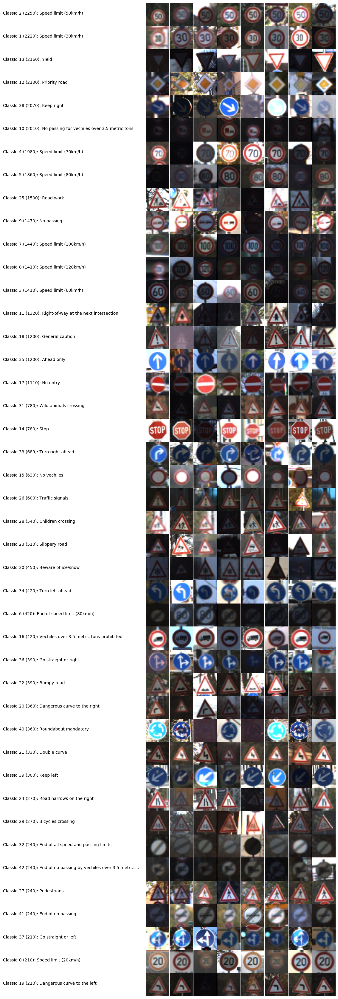

Test set sample images (RGB): 100%|██████████| 43/43 [00:15<00:00,  3.21labels/s]


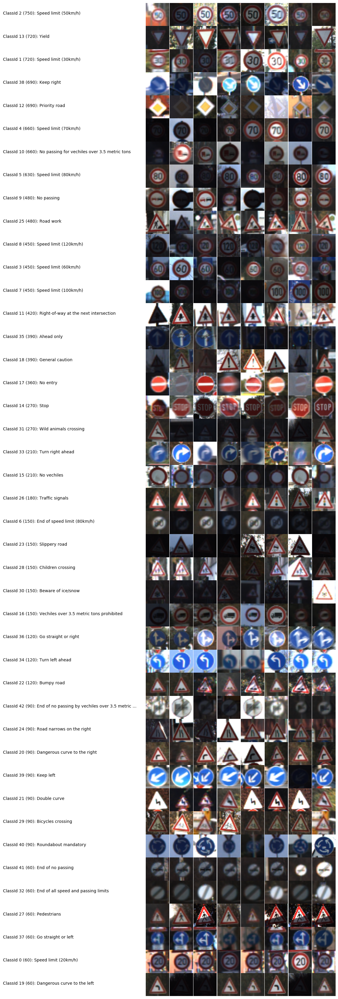

In [14]:
def draw_sample_labelsets(datasettxt, sortedlabels, labeldata, dataset, cmap=None):
    n_samples = 8
    n_labels = len(sortedlabels)
    
    # size of each sample
    fig = plt.figure(figsize=(n_samples*1.8, n_labels))
    w_ratios = [1 for n in range(n_samples)]
    w_ratios[:0] = [int(n_samples*0.8)]
    h_ratios = [1 for n in range(n_labels)]

    # gridspec
    time.sleep(1) # wait for 1 second for the previous print to appear!
    grid = gridspec.GridSpec(n_labels, n_samples+1, wspace=0.0, hspace=0.0, width_ratios=w_ratios, height_ratios=h_ratios)
    labelset_pbar = tqdm(range(n_labels), desc=datasettxt, unit='labels')
    for a in labelset_pbar:
        classId = labeldata[str(sortedlabels[n_labels-a-1])]['label']
        description = classLabelList[classLabelList.ClassId==classId].SignName.to_string(header=False,index=False)
        count = labeldata[str(sortedlabels[n_labels-a-1])]['count']
        for b in range(n_samples+1):
            i = a*(n_samples+1) + b
            ax = plt.Subplot(fig, grid[i])
            if b == 0:
                ax.annotate('ClassId %d (%d): %s'%(classId, count, description), xy=(0,0), xytext=(0.0,0.5))
                ax.set_xticks([])
                ax.set_yticks([])
                fig.add_subplot(ax)
            else:
                random_i = random.choice(labeldata[str(sortedlabels[n_labels-a-1])]['samples'])
                image = dataset[random_i]
                if cmap == None:
                    ax.imshow(image)
                else:
                    # yuv = cv2.split(image)
                    # ax.imshow(yuv[0], cmap=cmap)
                    ax.imshow(image, cmap=cmap)
                ax.set_xticks([])
                ax.set_yticks([])
                fig.add_subplot(ax)
    
        # hide the borders\
        if a == (n_labels-1):
            all_axes = fig.get_axes()
            for ax in all_axes:
                for sp in ax.spines.values():
                    sp.set_visible(False)

    plt.show()

draw_sample_labelsets('Train set sample images (RGB)', train_sortedLabels, train_labelInfo, X_train)
draw_sample_labelsets('Test set sample images (RGB)', test_sortedLabels, test_labelInfo, X_test)


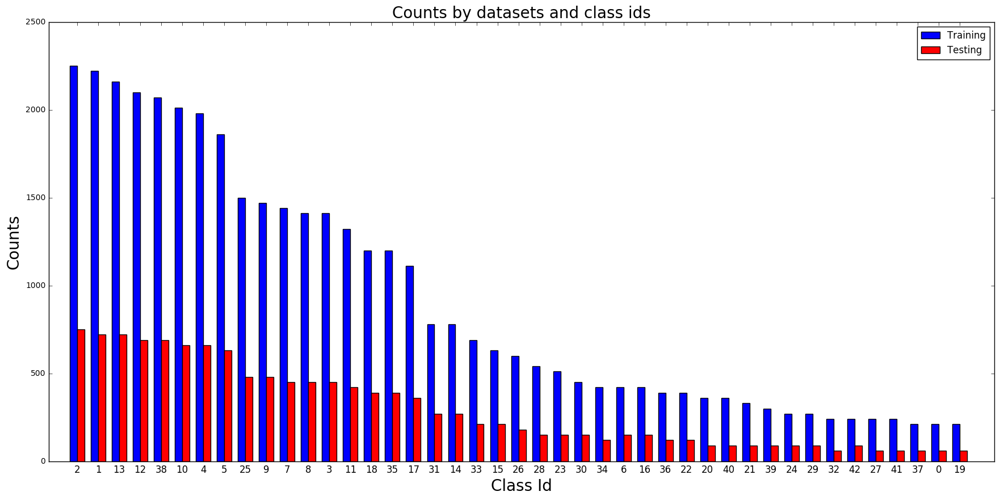

In [15]:
### Data exploration visualization goes here.
### Feel free to use as many code cells as needed.
def my_reverse(list):
    newlist = []
    for n in list:
        newlist[:0] = [n]
    return newlist

# Plot bar graph of class id count distribution
n_labels = len(train_sortedLabels)
training_labels = my_reverse(train_sortedLabels)
training_counts = [train_labelInfo[n]['count'] for n in training_labels]
testing_counts = [test_labelInfo[n]['count'] for n in training_labels]

ind = np.arange(n_labels)
width = 0.35

fg, ax = plt.subplots(figsize=(n_labels/2, 10))
rects1 = ax.bar(ind+1, training_counts, width, color='b')
rects2 = ax.bar(ind+1+width, testing_counts, width, color='r')

# add some text for labels, title and axes ticks
ax.set_ylabel("Counts", fontsize=20)
ax.set_title("Counts by datasets and class ids", fontsize=20)
ax.set_xticks(ind + width+1.0)
ax.set_xticklabels(training_labels, fontsize=12)
ax.set_xlabel("Class Id", fontsize=20)

ax.legend((rects1[0], rects2[0]), ('Training', 'Testing'))
plt.show()


In [16]:
# It seems that the 'sizes' (width, height) and 'coords' (x1, y1, x2, y2) features have the same values?
# Looks like we cannot get any real information from the 'coords' feature.
allsame = True
for i in range(n_train):
    if not (train['sizes'][i].all() == train['coords'][i].all()):
        allsame = False
if allsame:
    print("train['sizes'] == train['coords']!!!\nIgnoring 'coords' feature in train dataset.\n")

allsame = True
for i in range(n_test):
    if not (test['sizes'][i].all() == test['coords'][i].all()):
        allsame = False
if allsame:
    print("test['sizes'] == test['coords']!!!\nIgnoring 'coords' feature in test dataset.\n")



test['sizes'] == test['coords']!!!
Ignoring 'coords' feature in test dataset.



----

## Step 2: Design and Test a Model Architecture

Design and implement a deep learning model that learns to recognize traffic signs. Train and test your model on the [German Traffic Sign Dataset](http://benchmark.ini.rub.de/?section=gtsrb&subsection=dataset).

There are various aspects to consider when thinking about this problem:

- Your model can be derived from a deep feedforward net or a deep convolutional network.
- Play around preprocessing techniques (normalization, rgb to grayscale, etc)
- Number of examples per label (some have more than others).
- Generate fake data.

Here is an example of a [published baseline model on this problem](http://yann.lecun.com/exdb/publis/pdf/sermanet-ijcnn-11.pdf). It's not required to be familiar with the approach used in the paper but, it's good practice to try to read papers like these.

### Implementation

Use the code cell (or multiple code cells, if necessary) to implement the first step of your project. Once you have completed your implementation and are satisfied with the results, be sure to thoroughly answer the questions that follow.

Features are now converted YUV!


Train set sample images (YUV): 100%|██████████| 43/43 [00:15<00:00,  3.29labels/s]


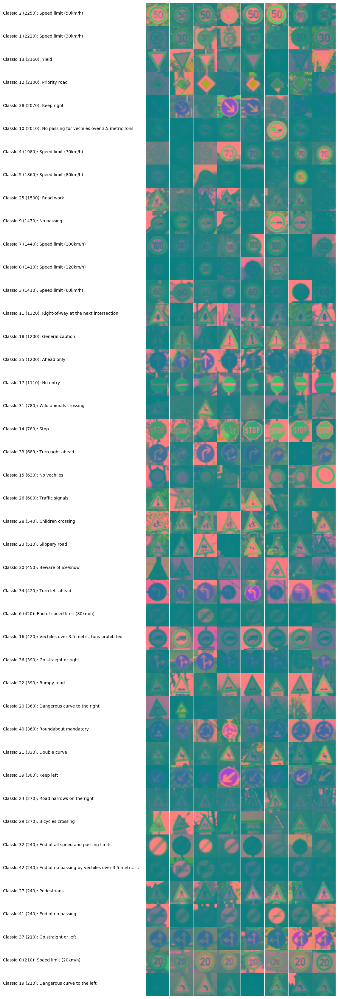

Test set sample images (YUV): 100%|██████████| 43/43 [00:15<00:00,  3.19labels/s]


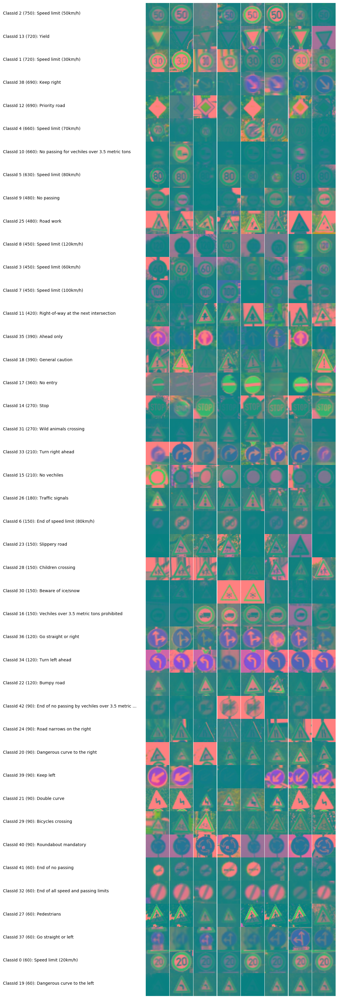

In [17]:
### Preprocess the data here.
### Feel free to use as many code cells as needed.
###
### Step 1:
### We need to condition the training and testing data.  We need to convert the color image to grey scale since
### RGB features in the traffic sign will not contribute to its classification and recognition.  We will use
### OpenCV to do the conversion as we did in the earlier Lane Line Project 1 to reduce the size of the features
### so as to allow the Stochastic Gradient Descent Machine Learning algorithm to process more relivent data to
### learn faster.  In referencing the article: http://yann.lecun.com/exdb/publis/pdf/sermanet-ijcnn-11.pdf,
### page 2, section III. EXPERIMENTS, subsection A. Data Preparation, item 2) Pre-processing, we find 
### converting the feature RGB color space to YUV seems to improve classification and recognition, and we will
### follow this path as well.  Since our training and test features are already at 32x32 resolution, we just
### need to do the conversion to YUV color space in this step.

def RGB2YUV(image_data):
    yuv_image_data = []
    for i in range(len(image_data)):
        yuv_image_data.append(cv2.cvtColor(image_data[i], cv2.COLOR_RGB2YUV))
    return np.array(yuv_image_data)

if is_features_yuv:
    print('Nothing done.  Features are already in YUV!')
else:
    X_train = RGB2YUV(X_train)
    y_train = np.copy(y_train)
    X_test = RGB2YUV(X_test)
    y_test = np.copy(y_test)
    is_features_yuv = True
    print('Features are now converted YUV!')

# draw some sample pictures.
draw_sample_labelsets('Train set sample images (YUV)', train_sortedLabels, train_labelInfo, X_train)
draw_sample_labelsets('Test set sample images (YUV)', test_sortedLabels, test_labelInfo, X_test)


Features Y are now normalized and converted to float32!


Train set sample images (Normalized Y): 100%|██████████| 43/43 [00:15<00:00,  2.00labels/s]


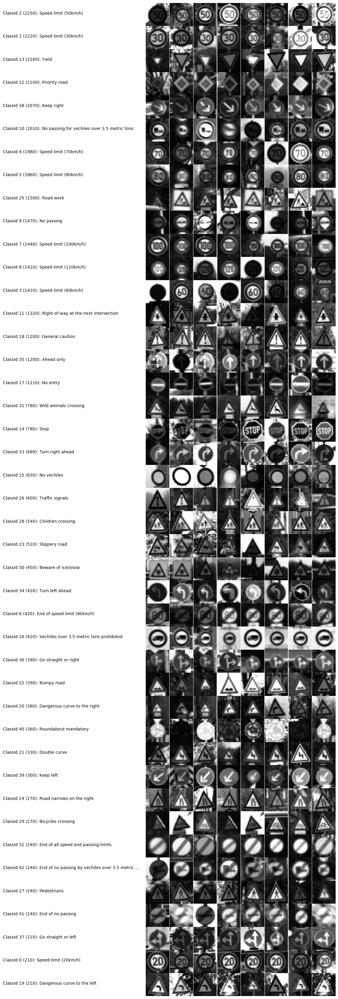

Test set sample images (Normalized Y): 100%|██████████| 43/43 [00:15<00:00,  2.00labels/s]


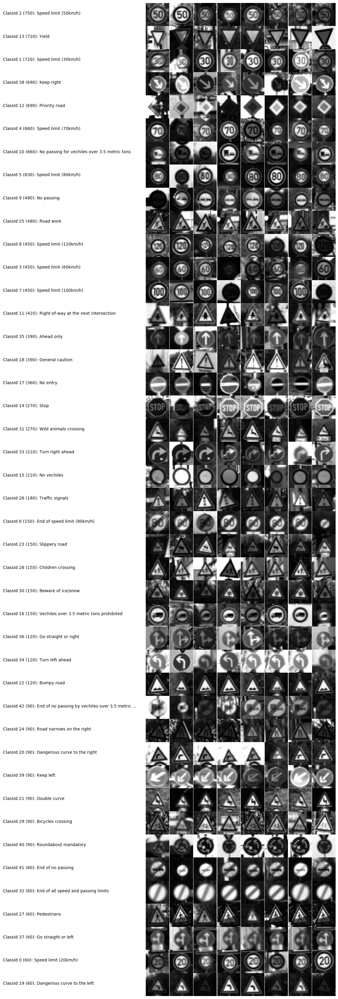

In [18]:
### Preprocess the data here.
### Feel free to use as many code cells as needed.
###
### Step 2:
### We will implement the Min-Max scaling function and apply it to the Y in the UV color space as described in
### in the article: http://yann.lecun.com/exdb/publis/pdf/sermanet-ijcnn-11.pdf, page 2, section III.
### EXPERIMENTS, subsection A. Data Preparation, item 2) Pre-processing.  We will apply this to images we
### converted in step 1.
###
### This is needed as we did in the TensorFlow Neural Network Lab assignment to process the image into a
### well conditioned features so we are centered on a zero mean with equal variance to make it easy for
### our neural network to perform Gradient Descent faster to train its weights and biases to the given labels.
### We will also convert the features from uint8 to float32 to make it easier for GPUs to process the data
### Using their thousands of multi-cores parallel processing units in a CUDA enabled Deep Learning system.

def normalize_Y_in_YUV(image_data):
    """
    Normalize the image data with Min-Max scaling to a range of [0.1, 0.9]
    :param image_data: The image data to be normalized
    :return: Normalized image data
    """
    a = 0.1
    b = 0.9
    y_min = 0
    y_max = 255
    yuv_image_data = []

    for i in range(len(image_data)):
        yuv = cv2.split(image_data[i])  
        y = np.array(yuv[0], np.float32)
        y = a + ( ( (y - y_min)*(b - a) )/( y_max - y_min ) )
        u = np.array(yuv[1], np.float32)
        v = np.array(yuv[2], np.float32)
        yuv = np.dstack((y, u, v))
        yuv_image_data.append(yuv)
    return np.array(yuv_image_data)

def normalize_Y(image_data):
    """
    Normalize the image data with Min-Max scaling to a range of [0.1, 0.9]
    :param image_data: The image data to be normalized
    :return: Normalized image data
    """
    a = 0.1
    b = 0.9
    y_min = 0
    y_max = 255
    y_image_data = []

    for i in range(len(image_data)):
        yuv = cv2.split(image_data[i])  
        y = np.array(yuv[0], np.float32)
        y = a + ( ( (y - y_min)*(b - a) )/( y_max - y_min ) )
        y_image_data.append(y)
    return np.array(y_image_data)

if is_features_y_normal:
    print('Nothing done.  Features Y are already normalized and converted to float32!')
else:
    #X_train = normalize_Y_in_YUV(X_train)
    #X_test = normalize_Y_in_YUV(X_test)
    X_train = normalize_Y(X_train)
    X_test = normalize_Y(X_test)
    is_features_y_normal = True
    print('Features Y are now normalized and converted to float32!')

# draw some sample pictures.
draw_sample_labelsets('Train set sample images (Normalized Y)', train_sortedLabels, train_labelInfo, X_train, cmap='gray')
draw_sample_labelsets('Test set sample images (Normalized Y)', test_sortedLabels, test_labelInfo, X_test, cmap='gray')


In [19]:
### Preprocess the data here.
### Feel free to use as many code cells as needed.
###
### Step 3:
### We will apply One-Hot Encoding to our numeric traffic labels.
### This is a way to represent our labels mathematically so that we have a vector that contains
### as many values as we have classes.  The value that we want to set for the correct class is set
### to 1 while all others are set to 0.  We will follow this by changing our One-Hot Encoded labels
### to float32 so as to allow them to be multiplied against the features in Tensorflow using the
### thousands of multi-cores parallel processing units in a CUDA enabled Deep Learning system.


assert is_features_y_normal

if is_labels_encod:
    print('Nothing done.  Labels are already One-Hot encoded!')
else:
    encoder = LabelBinarizer()
    encoder.fit(y_train)
    y_train_onehot = encoder.transform(y_train)
    y_test_onehot = encoder.transform(y_test)
    is_labels_encod = True
    y_train_onehot = y_train_onehot.astype(np.float32)
    y_test_onehot = y_test_onehot.astype(np.float32)
    is_labels_float32 = True
    
    # put together a onehot label table
    onehot_labels = [n for n in range(len(train_sortedLabels))]
    onehot_labels = encoder.transform(onehot_labels)
    onehot_labels = onehot_labels.astype(np.float32)

    print('Labels are now One-Hot encoded and converted to float32!')


Labels are now One-Hot encoded and converted to float32!


### Question 1 

_Describe the techniques used to preprocess the data._

**Answer:**

We need to condition the training and testing data.  We need to convert the color image to grey scale since RGB features in the traffic sign may not contribute to its classification and recognition, or at least not significately enough to justify increasing the feature by an additional 2 color channels.  By decreasing the size of the features to a single color channel, a 3 to 1 feature reduction, we will allow a wider range of model architectures into our design palettes, since we will be using Compute Unified Device Architecture (CUDA).  CUDA is a parellel computing platform, programming model, and application programming interface (API) created by NVIDIA and implemented by the graphics processing units (GPUs) that they produce.  CUDA is compiled against Tensorflow, the open source software library for numerical computation that we will be using to build our traffic sign recognition architecture and model.

<img src="https://upload.wikimedia.org/wikipedia/commons/thumb/5/59/CUDA_processing_flow_%28En%29.PNG/300px-CUDA_processing_flow_%28En%29.PNG" title="CUDA Architecture">

The NVIDIA GPUs have various performance and memory resources.  In the middle of our design, we ran into a problem with our initial CUDA GPU, the GeForce GTX970, because one of our earlier models could not fit into its 4GB memory, so even our grey scaled feature could not be use for excelerated training.  After pondering a bit, we went ahead and purchased the top of the line NVIDIA Titan X with Pascal GPU microarchitecture, 12GB of GDDR5X memory, 384bit memory bus and 480GB/s of memory bandwidth.  Using CUDA will segnificantly speed the training of our final model, so the cost was justified.  See a discussion of this topic in the class forums: https://carnd-udacity.atlassian.net/wiki/display/CAR/questions/12617874/gtx970-too-low-powered.  Although after buying the Titan X, we discovered a way to batch read the test dataset without averaging the accuracy score, but that would have limited our option for the final model architecture.

##### Step 1:
We will use OpenCV to do the conversion as we did in the earlier Lane Line Project 1 to reduce the size of the features so as to allow the Stochastic Gradient Descent Machine Learning algorithm to process more relivent data to learn faster.  In referencing the article: http://yann.lecun.com/exdb/publis/pdf/sermanet-ijcnn-11.pdf, page 2, section III. EXPERIMENTS, subsection A. Data Preparation, item 2) Pre-processing, we find converting the feature RGB color space to YUV first seems to improve classification and recognition, and we will follow this path as well.  Since our training and test features are already at 32x32 resolution, we just need to do the conversion to YUV color space in this step.  Y stands for the luma component (the brightness) and U and V are the chrominance (color) components.

##### Step 2:
We will implement the Min-Max scaling function and apply it to the Y (luma) in the UV color space as described in the article: http://yann.lecun.com/exdb/publis/pdf/sermanet-ijcnn-11.pdf, page 2, section III. EXPERIMENTS, subsection A. Data Preparation, item 2) Pre-processing.  We will apply this to images we converted in step 1. This is needed as we did in the TensorFlow Neural Network Lab assignment to process the image into a well conditioned feature so we are centered on a zero mean with equal variance to make it easy for our neural network to perform Gradient Descent faster to train its weights and biases to the given labels. We will also convert the features from uint8 to float32 to make it easier for GPUs to process the data using their thousands of multi-cores parallel processing units in a CUDA enabled system to speed up the training and predictions of the model.

##### Step 3:
We will apply One-Hot Encoding to our numeric traffic labels. This is a way to represent our labels mathematically so that we have a vector that contains as many values as we have classes.  The value that we want to set for the correct class is set to 1 while all others are set to 0.  We will follow this by changing our One-Hot Encoded labels to float32 so as to allow them to be matrix multiplied against the features in Tensorflow using the thousands of multi-cores parallel processing units in a CUDA enabled system.


In [20]:
### Generate data additional (if you want to!)
### Feel free to use as many code cells as needed.
###
### In referencing the article: http://yann.lecun.com/exdb/publis/pdf/sermanet-ijcnn-11.pdf,
### page 2, section III. EXPERIMENTS, subsection A. Data Preparation, item 2) Pre-processing, we find 
### that if we generate a "Jittered dataset" and use it exclusively for training, it should drop our
### validation error from around 1.31% to 1.08%.  We can follow the same procedure as described in
### this section, and generate additional 5X samples by randomly perturbed in position ([-2,2] pixels),
### in scale ([.9,1.1] ratio) and rotation ([-15,+15] degrees).  As described in the reference:
### "When a dataset does not naturally contain those deformations, adding them synthetically will yield
### more robust learning to potential deformations in the test set."  The other reason to generate
### a new test set is that the class labels are not evenly distributed, we can generate a more evenly
### distributed set of dataset for training and leave the original set for validation.  

assert is_features_yuv
assert is_features_y_normal
assert is_labels_encod
assert is_labels_float32

### Data exploration visualization goes here.
### Feel free to use as many code cells as needed.

def labelset2_info(labelsettxt, labelset):
    # get stats for the labels
    labelStats = pd.DataFrame(labelset)
   
    print(labelsettxt, "set label stats:")
    print(labelStats.describe())
   
    labelsInfo = {}
    modeCount = 0
    modeLabel = 0
    for i in range(len(labelset)):
        # for each label
        label = str(labelset[i])
      
        # try to see if there is a hash hit
        labelInstance = labelsInfo.get(label, {'count': 0, 'samples':[]})
      
        # add to the count
        count = labelInstance['count'] + 1
      
        # add to samples if less than 8
        samples = labelInstance['samples']
        if len(samples) < 8:
            samples.append(i)
    
      # put in the last Index
        labelsInfo[label] = {'lastIdx':i, 'count': count, 'label':int(label), 'samples':samples}
      
        # update most common size
        if count > modeCount:
            modeCount = count 
            modeSize = labelsInfo[label]
    
    # get the list of counts and sort them
    sortedLabels = list(labelsInfo.keys())
   
    def compare_count(label):
        return labelsInfo[label]['count']
   
    sortedLabels.sort(key=compare_count)

    # get the unique number of original picture sizes and the min and max last instance
    n_labels = len(sortedLabels)
    minLabel = sortedLabels[0]
    maxLabel = sortedLabels[n_labels-1]

    # print the stats
    print("\nNumber of unique labels in", labelsettxt,"set: ", n_labels)

    print("\nDistribution of", labelsettxt, "set labels:")
    for n in range(n_labels):
        i = sortedLabels[n_labels-n-1]
        classId = labelsInfo[str(i)]['label']
        index = labelsInfo[str(i)]['lastIdx']
        count = labelsInfo[str(i)]['count']
        description = classLabelList[classLabelList.ClassId==classId].SignName.to_string(header=False,index=False)
        print(labelsettxt, " set count: {0:4d}  ClassId: {1:02d}  Description: {2}".format(count, classId, description))

    return n_labels, sortedLabels, labelsInfo, minLabel, maxLabel, modeLabel

# move our original training dataset for validation 
X_valid = X_train
y_valid = y_train
y_valid_onehot = y_train_onehot
old_y_test_labels = np.append(test['labels'], train['labels'], axis=0)

# make sure we don't use our previous training data.
X_train = []
y_train = []
y_train_onehot = []

print("Original training set is now the validation set.")

Original training set is now the validation set.


In [21]:
### After thinking this over, we believe generating this additional dataset now, is not appropriate
### after all, what would be better is to generate this needed training data on the fly in batches
### when required by then training.  The following are just functions for doing the generation based
### on already collected data about the label distribution from the last section.  We will now combine
### the current training and testing set into one for testing, and generate our training and validation
### sets on the fly.
###
### set up our training and validating dataset/batch generator.

# function to shift images x or y offsets
def shiftxy(image, xoffset, yoffset):
    rows,cols, depth = image.shape
    M = np.float32([[1,0,xoffset],[0,1,yoffset]])
    res = cv2.warpAffine(np.copy(image),M,(cols,rows))
    assert (res.shape[0] == 32)
    assert (res.shape[1] == 32)
    return res
    
# function to rotate images by given degrees
def rotate(image, degree):
    rows, cols, depth = image.shape
    M = cv2.getRotationMatrix2D((cols/2,rows/2), degree, 1)
    res = cv2.warpAffine(image, M, (cols,rows))
    assert (res.shape[0] == 32)
    assert (res.shape[1] == 32)
    return res
    
# function to resize the image
def scale(image, ratio):
    rows, cols, depth = image.shape
    newrows = int(ratio*rows)
    newcols = int(ratio*cols)
    res = cv2.resize(image, (newrows, newcols), interpolation=cv2.INTER_AREA)
    if newrows*newcols > 1024:
        # image is larger than 32x32, randomly crop the image back to 32x32
        xoffset = (newcols-32)-int(random.random()*float(newcols-32))
        yoffset = (newrows-32)-int(random.random()*float(newrows-32))
        cropped = res[xoffset:xoffset+32, yoffset:yoffset+32]
        res = cropped
    else:
        # image is smaller than before, randomly insert it into a 32x32 canvas
        if newrows*newcols < 1024:
            tmpimage = np.copy(image)*0
            xoffset = (32-newcols)-int(random.random()*float(32-newcols))
            yoffset = (32-newrows)-int(random.random()*float(32-newrows))
            tmpimage[xoffset:newrows+xoffset, yoffset:newcols+yoffset] = res
            res = tmpimage
    assert (res.shape[0] == 32)
    assert (res.shape[1] == 32)
    return res

def gaussian_blur(img, kernel_size):
    # Applies a Gaussian Noise kernel
    return cv2.GaussianBlur(img, (kernel_size, kernel_size), 0)

def intensity(image, factor):
    maxIntensity = 255.0 # depends on dtype of image data
    phi = 1
    theta = 1
    image0 = (maxIntensity/phi)*(image/(maxIntensity/theta))**factor
    return np.array(image0, dtype=np.uint8)

def jitterA(simage):
    # set up the random jitter
    x = int(random.random() * 6) - 3
    y = int(random.random() * 6) - 3
    degree = int(random.random()*30.0)-15
    ratio = random.random()*0.3 + 0.85
    brightness = (random.random()*1.5)+0.5
    
    image = intensity(scale(rotate(shiftxy(simage,x,y),degree),ratio), brightness)
    return image

def jitterB(simage):
    # set up the random jitter
    x = int(random.random() * 12) - 6
    y = int(random.random() * 6) - 3
    degree = int(random.random()*30.0)-15
    ratio = random.random()*0.4 + 0.80
    kernel_size = int(random.random()*3)*2+1
    
    image = scale(rotate(shiftxy(simage,x,y),degree),ratio)
    return image

def jitterC(simage):
    # set up the random jitter
    x = int(random.random() * 4) - 2
    y = int(random.random() * 4) - 2
    degree = int(random.random()*30.0)-15
    ratio = random.random()*0.2 + 0.9
    
    image = scale(rotate(shiftxy(simage,x,y),degree),ratio)
    return image

def jitterD(simage):
    # set up the random jitter
    x = int(random.random() * 4) - 2
    y = int(random.random() * 4) - 2
    degree = int(random.random()*30.0)-15
    ratio = random.random()*0.4 + 0.8
    kernel_size = int(random.random()*2)
    brightness = (random.random()*1.5)+0.5
    if kernel_size == 0:
        image = intensity(scale(rotate(shiftxy(simage,x,y),degree),ratio),brightness)
    else:
        kernel_size = 3
        image = gaussian_blur(intensity(scale(rotate(shiftxy(simage,x,y),degree),ratio), brightness), kernel_size)
    return image

def jitterE(simage):
    # set up the random jitter
    x = int(random.random() * 6) - 3
    y = int(random.random() * 12) - 6
    degree = int(random.random()*40.0)-20
    ratio = random.random()*0.3 + 0.85
    brightness = (random.random()*1.5)+0.5
    
    image = intensity(scale(rotate(shiftxy(simage,x,y),degree),ratio),brightness)
    return image


def next_batch(batch_size, jitter=[jitterA, jitterB, jitterC, jitterD, jitterE]):
    sortedlabels = [train_sortedLabels]
    sourcefeatureset = [train]
    sourcelabelset = [train_labelInfo]
    tmp_y_labelset = []
    tmp_y_onehot = []
    tmp_x_featureset = []
    for i in range(batch_size):
        source = 0
        sfeature = sourcefeatureset[source]
        slabel = sourcelabelset[source]

        # get a random label
        n_labels = len(slabel)
        # classNum = int(random.random()*n_labels)
        classNum = sfeature['labels'][int(random.random()*len(sfeature['labels']))]

        # get a random index from the random source of that random label
        rindex = int(random.random() * len(slabel[str(classNum)]['samples']))
        sindex = slabel[str(classNum)]['samples'][rindex]
        simage = sfeature['features'][sindex]
        
        tmp_y_labelset.append(classNum)
        tmp_y_onehot.append(onehot_labels[classNum])
        jitterRoutine = int(random.random()*len(jitter))
        tmp_x_featureset.append(jitter[jitterRoutine](simage))


    # return normalize_Y_in_YUV(RGB2YUV(tmp_x_featureset)), tmp_y_labelset, tmp_y_onehot
    return normalize_Y(RGB2YUV(tmp_x_featureset)), tmp_y_labelset, tmp_y_onehot

### generate a training set
def generate_batch(epochs, batch_size, jitters=[jitterA, jitterB, jitterC, jitterD, jitterE]):
    newbatchsize = epochs*batch_size
    return next_batch(newbatchsize, jitters)

def generate_batch_with_pbar(epochs, batch_size, jitters=[jitterA, jitterB, jitterC, jitterD, jitterE]):
    X = []
    y = []
    y_onehot = []

    batches_pbar = tqdm(range(epochs), desc='Generating Training', unit='batches')
    for b in batches_pbar:
        X_trainX, y_trainX, y_trainX_onehot = next_batch(batch_size, jitters)
        X[:0] = X_trainX
        y[:0] = y_trainX
        y_onehot[:0] = y_trainX_onehot
    return X, y, y_onehot

epochs = 20
batch_size = 10000
X_train2, y_train2, y_train2_onehot = generate_batch_with_pbar(epochs, batch_size)
    
# show the stats
train2_labels, train2_sortedLabels, train2_labelInfo, train2_minLabel, train2_maxLabel, train2_modeLabel = labelset2_info("training", y_train2)
valid2_labels, valid2_sortedLabels, valid2_labelInfo, valid2_minLabel, valid2_maxLabel, valid2_modeLabel = labelset2_info("validation", y_valid)
test2_labels, test2_sortedLabels, test2_labelInfo, test2_minLabel, test2_maxLabel, test2_modeLabel = labelset2_info("testing", y_test)


Generating Training: 100%|██████████| 20/20 [00:37<00:00,  1.89s/batches]


training set label stats:
                   0
count  200000.000000
mean       15.812850
std        12.013636
min         0.000000
25%         5.000000
50%        12.000000
75%        25.000000
max        42.000000

Number of unique labels in training set:  43

Distribution of training set labels:
training  set count: 11319  ClassId: 01  Description: Speed limit (30km/h)
training  set count: 11299  ClassId: 02  Description: Speed limit (50km/h)
training  set count: 10935  ClassId: 13  Description: Yield
training  set count: 10853  ClassId: 12  Description: Priority road
training  set count: 10480  ClassId: 38  Description: Keep right
training  set count: 10425  ClassId: 10  Description: No passing for vechiles over 3.5 metric tons
training  set count: 10032  ClassId: 04  Description: Speed limit (70km/h)
training  set count: 9483  ClassId: 05  Description: Speed limit (80km/h)
training  set count: 7595  ClassId: 25  Description: Road work
training  set count: 7436  ClassId: 09  Descrip

Generated Train set sample images (Normalized Y): 100%|██████████| 43/43 [00:15<00:00,  2.28labels/s]


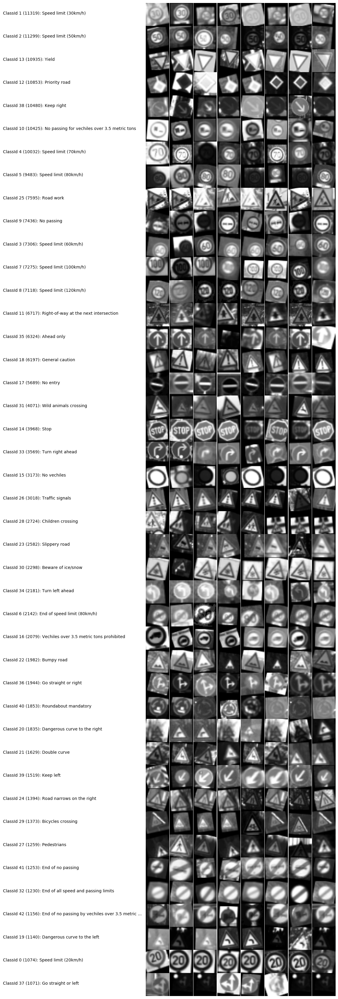

Original Train as Validate set sample images (Normalized Y): 100%|██████████| 43/43 [00:15<00:00,  2.27labels/s]


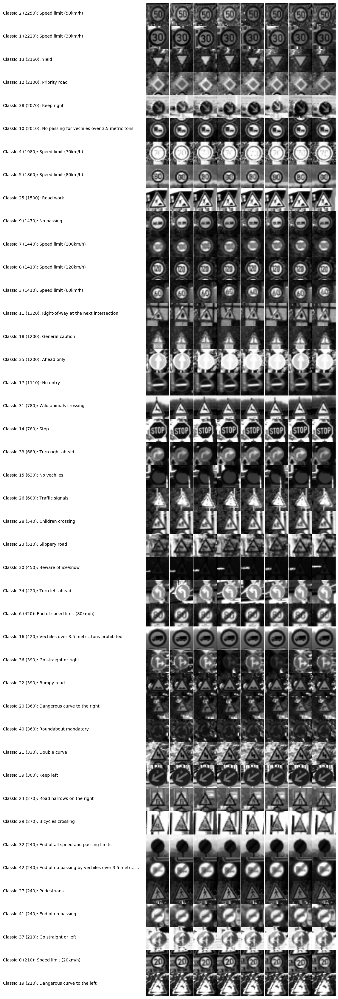

Test set sample images (Normalized Y): 100%|██████████| 43/43 [00:15<00:00,  2.58labels/s]


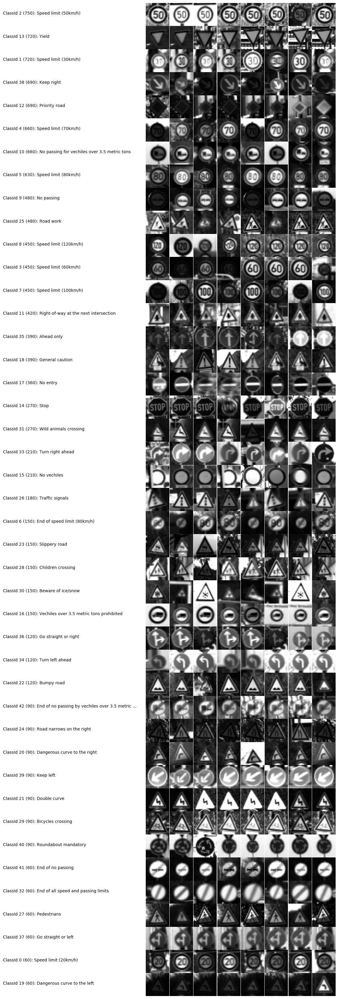

In [22]:
### Generate data additional (if you want to!)
### Visualize the new Jittered Dataset
### get stats for the labels

# draw some sample pictures.
draw_sample_labelsets('Generated Train set sample images (Normalized Y)', train2_sortedLabels, train2_labelInfo, X_train2, cmap='gray')
draw_sample_labelsets('Original Train as Validate set sample images (Normalized Y)', valid2_sortedLabels, valid2_labelInfo, X_valid, cmap='gray')
draw_sample_labelsets('Test set sample images (Normalized Y)', test2_sortedLabels, test2_labelInfo, X_test, cmap='gray')


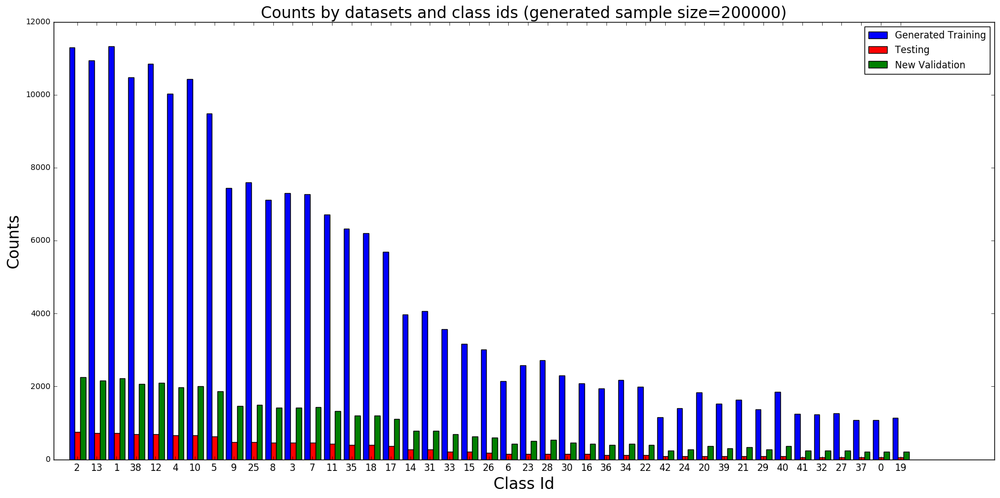

In [23]:
### Generate data additional (if you want to!)
# Plot bar graph of class id count distribution with the additional jittered dataset via batch sample

# Plot bar graph of new class id count distribution
n_labels = len(train2_sortedLabels)
training_labels = my_reverse(test2_sortedLabels)
training_counts = [train2_labelInfo[n]['count'] for n in training_labels]
validating_counts = [valid2_labelInfo[n]['count'] for n in training_labels]
testing_counts = [test2_labelInfo[n]['count'] for n in training_labels]

ind = np.arange(n_labels)
width = 0.35

fg, ax = plt.subplots(figsize=(n_labels/2, 10))
rects1 = ax.bar(ind*1.25+1.0, training_counts, width, color='b')
rects2 = ax.bar(ind*1.25+1.0+width, testing_counts, width, color='r')
rects3 = ax.bar(ind*1.25+1.0+width*2, validating_counts, width, color='g')

# add some text for labels, title and axes ticks
ax.set_ylabel("Counts", fontsize=20)
ax.set_title("Counts by datasets and class ids (generated sample size=%d)"%(sum(training_counts)), fontsize=20)
ax.set_xticks(ind*1.25 + 1.5)
ax.set_xticklabels(training_labels, fontsize=12)
ax.set_xlabel("Class Id", fontsize=20)

ax.legend((rects1[0], rects2[0], rects3), ('Generated Training', 'Testing', 'New Validation'))
plt.show()


In [24]:
### Split the data into training/validation/testing sets here.
### Feel free to use as many code cells as needed.
###
### No Need - the next_batch automatically randomized the training and validation sets

### Define next batch for validate
def next_train(index, batch_size):
    batch_count = int(math.ceil(len(y_train2)/batch_size))
    current_batch = index % batch_count
    # print("batch_size: ", batch_size, "batch_count: ", batch_count, "current_batch: ", current_batch)
    batch_start = current_batch*batch_size
    batch_images = X_train2[batch_start:batch_start + batch_size]
    batch_labels = y_train2_onehot[batch_start:batch_start + batch_size]
    return (batch_images, batch_labels)

def next_validate(index, batch_size):
    batch_count = int(math.ceil(len(y_valid)/batch_size))
    current_batch = index % batch_count
    # print("batch_size: ", batch_size, "batch_count: ", batch_count, "current_batch: ", current_batch)
    batch_start = current_batch*batch_size
    batch_images = X_valid[batch_start:batch_start + batch_size]
    batch_labels = y_valid_onehot[batch_start:batch_start + batch_size]
    return (batch_images, batch_labels)

def next_test(index, batch_size):
    batch_count = int(math.ceil(len(y_test)/batch_size))
    current_batch = index % batch_count
    # print("batch_size: ", batch_size, "batch_count: ", batch_count, "current_batch: ", current_batch)
    batch_start = current_batch*batch_size
    batch_images = X_test[batch_start:batch_start + batch_size]
    batch_labels = y_test_onehot[batch_start:batch_start + batch_size]
    return (batch_images, batch_labels)

print('No Need - The next_batch automatically randomized the training sets!')
print('          The new generated dataset will be fetched in batches with correct labels!')
print('          We will use the entire original training set as the validation set')


No Need - The next_batch automatically randomized the training sets!
          The new generated dataset will be fetched in batches with correct labels!
          We will use the entire original training set as the validation set


### Question 2

_Describe how you set up the training, validation and testing data for your model. If you generated additional data, why?_

**Answer:**

In referencing the article: http://yann.lecun.com/exdb/publis/pdf/sermanet-ijcnn-11.pdf, page 2, section III. EXPERIMENTS, subsection A. Data Preparation, item 2) Pre-processing, we find that if we generate a "Jittered dataset" and use it exclusively for training, it should drop our validation error from around 1.31% to 1.08%.  We can follow the same procedure as described in this section, and generate additional 5X samples by randomly perturbed in position ([-2,2] pixels), in scale ([.9,1.1] ratio) and rotation ([-15,+15] degrees).  As described in the reference: "When a dataset does not naturally contain those deformations, adding them synthetically will yield more robust learning to potential deformations in the test set."  The other reason to generate a new test set is that the class labels are not evenly distributed, we can generate a more evenly distributed set of dataset for training and leave the original set for validation.  Please review the last 5 cells where we generated and visualized jittered samples.

After experimenting and thinking this over, we believe generating this additional dataset now, is not appropriate after all, what would be better is to generate this needed training data on the fly in batches when required by then training.  We experimented with various jittering combinations and ranges, including additional brightness factors and gaussian blur we learn from project 1.  We put together 5 jitter combinations jitterA through jitterE that we found useful through many experiments during our model design process.  These jittering combination became our tools to increase the number of samples to train our final model by randomly choosing the base image from the training set and randomly jitter them through one of the 5 jitter combinations.  Now our complete training dataset is moved to be our validation dataset, and we will generate our training dataset in batches on the fly.

When we first created our initial training dataset generator, we decided that a balanced distribution was more likely to help the model generalize better, and perform better on the test dataset; however, in pratice, in particular with the German Traffic Sign dataset, using the same class distribution as that of the training set, actually performed better.  We come to the conclusion that in theory it should be better, but in practice, the network just want more connections to what is more probable to get a better prediction.  To see a discussion of this in the class forums, please refer to: https://carnd-udacity.atlassian.net/wiki/questions/10322627/project-2-unbalanced-data-generating-additional-data-by-jittering-the-original-image.

In [24]:
### Define your architecture here.
### Feel free to use as many code cells as needed.
###
### VERSION 1:  This is a straight forward 2 layer Convolution Model.
###             We were able to achieve 0.9632626175880432 testing accuracy using this model.
### Based on:
###    https://www.tensorflow.org/versions/r0.11/tutorials/mnist/pros/index.html
### deep multi-layer convolutional networks or (ConvNets) are great at classifying
### pictures of traffic signs and other picture recognition, such as pictures from the MNIST database.
### In particular, www.tensorflow.org has examples and tutorials on how to set up such a network for
### performing just this classification.  We will start with their example and use some of the insights
### gleamed from the yann.lecum.com article to set up our initial architecture.
### Since we are in a Jupyter interactive session, we will follow the www.tensorflow.com's MNIST PRO
### tutorial and use an InteractiveSession to access the and build a computation graph as we build our
### ConvNet for traffic sign classification and recognition.

# set up tensorflow
import tensorflow as tf

# define our new weighs and bias variables functions.
# we need to initialize the weights with a small amount of noise for symmetry
# breaking, and to prevent 0 gradients.
def weight_variable(shape):
  initial = tf.truncated_normal(shape, stddev=0.1)
  return tf.Variable(initial)

# Since we are using ReLU neurons, it is also good practice to initialize them
# with a slightly positive initial bias to avoid "dead neurons".
def bias_variable(shape):
  initial = tf.constant(0.1, shape=shape)
  return tf.Variable(initial)

# define our conv2d and max_pool functions
# vanilla version conv2d - stride of one and zero padded
def conv2d(x, W):
  return tf.nn.conv2d(x, W, strides=[1, 1, 1, 1], padding='SAME')

# plain old max pooling over 2x2 blocks
def max_pool_2x2(x):
  return tf.nn.max_pool(x, ksize=[1, 2, 2, 1],
                        strides=[1, 2, 2, 1], padding='SAME')

# first convolution layer: our vanilla conv2d followed by max_pooling.
W_conv1 = weight_variable([5, 5, 1, 32])
b_conv1 = bias_variable([32])

# we will reshape our image from 32x32 to a 4d tensor, with the second and
# third dimensions corresponding to the image width and height and the final
# dimension corresponding to the number of color channel - 1 in our case.
x = tf.placeholder(tf.float32, [None, 32, 32])
x_image = tf.reshape(x, [-1,32,32,1])

# we then convolute x_image with the weight tensor and add the bias, our good old:
#    y = Wx + b
# apply the ReLU function then follow that by sending the result into our
# max_pooling over 2x2 blocks
h_conv1 = tf.nn.relu(conv2d(x_image, W_conv1) + b_conv1)
h_pool1 = max_pool_2x2(h_conv1)

# we then stack another convolution layer on top of this with 64 features
# for each 5 x 5 patch.
W_conv2 = weight_variable([5, 5, 32, 64])
b_conv2 = bias_variable([64])

# again we convolute the max pooling over 2x2 block result from the previous
# layer with the layer 2 weight tensor and layer 2 bias, another version of our
# good old:
#    y = Wx + b
# apply the ReLU function then follow that by sending the result into another
# max_pooling over 2x2 blocks
h_conv2 = tf.nn.relu(conv2d(h_pool1, W_conv2) + b_conv2)
h_pool2 = max_pool_2x2(h_conv2)

# we then send this into a densely (fully) connected network
# Our image is now just 8 x 8 of 64 features each.  We will send them into a
# fully connected layer with 1024 neurons to allow processing on the entire image.
W_fc1 = weight_variable([8*8*64, 1024])
b_fc1 = bias_variable([1024])

# We will reshape the tensor from the pooling layer into a batch of ventors,
# multiply by weight matrix, add bias and apply ReLU as before.
h_pool2_flat = tf.reshape(h_pool2, [-1, 8*8*64])
h_fc1 = tf.nn.relu(tf.matmul(h_pool2_flat, W_fc1) + b_fc1)

# We will add dropout function into the model to reduce overfitting by dropping
# out partial predictions that do not meet our threshold during training.
# This will allow us to turn it back on during testing so as to ensure we are
# predicting properly.
keep_prob = tf.placeholder(tf.float32)
h_fc1_drop = tf.nn.dropout(h_fc1, keep_prob)

# Finally our fully connected layer will be terminated to another fully connected
# layer of 1024 softmax regression functions.
W_fc2 = weight_variable([1024, 43])
b_fc2 = bias_variable([43])

# good old y = Wx + b again
y_conv = tf.matmul(h_fc1_drop, W_fc2) + b_fc2

# Define loss and optimizer
y_ = tf.placeholder(tf.float32, [None, 43])

#
#   tf.reduce_mean(-tf.reduce_sum(y_ * tf.log(tf.softmax(y)),
#                                 reduction_indices=[1]))
#
# can be numerically unstable.
#
# So here we use tf.nn.softmax_cross_entropy_with_logits on the raw
# outputs of 'y', and then average across the batch.

def setup_model_parameters(learning_rate):
    cross_entropy = tf.reduce_mean(tf.nn.softmax_cross_entropy_with_logits(y_conv, y_))
    train_step = tf.train.AdamOptimizer(learning_rate).minimize(cross_entropy)

    # Define test model prediction and accuracy functions
    correct_prediction = tf.equal(tf.argmax(y_conv,1), tf.argmax(y_,1))
    accuracy = tf.reduce_mean(tf.cast(correct_prediction, tf.float32))
    
    return cross_entropy, train_step, correct_prediction, accuracy

print("ConvNet Model for image classification has been defined")


ConvNet Model for image classification has been defined


In [46]:
### Define your architecture here.
### Feel free to use as many code cells as needed.
###
### VERSION 2:  This is a simple Convolution Model with both stage1 and stage2 output going into the
###             classifier.  We were able to achieve 0.9703092575073242 testing accuracy using this
###             model.
###
### We will build a deep mult-layer, multi-scaled convolutional network.  Based on both:
###    1. http://yann.lecun.com/exdb/publis/pdf/sermanet-ijcnn-11.pdf
###    2. https://www.tensorflow.org/versions/r0.11/tutorials/mnist/pros/index.html
### deep multi-layer, multi-scaled convolutional networks or (ConvNets) are great at classifying
### pictures of traffic signs and other picture recognition, such as pictures from the MNIST database.
### In particular, www.tensorflow.org has examples and tutorials on how to set up such a network for
### performing just this classification.  We will start with their example and use some of the insights
### gleamed from the yann.lecum.com article to set up our initial architecture.
### Since we are in a Jupyter interactive session, we will follow the www.tensorflow.com's MNIST PRO
### tutorial and use an InteractiveSession to access the and build a computation graph as we build our
### ConvNet for traffic sign classification and recognition.

# set up tensorflow
import tensorflow as tf

# define our new weighs and bias variables functions.
# we need to initialize the weights with a small amount of noise for symmetry
# breaking, and to prevent 0 gradients.
def weight_variable(shape):
  initial = tf.truncated_normal(shape, stddev=0.1)
  return tf.Variable(initial)

# Since we are using ReLU neurons, it is also good practice to initialize them
# with a slightly positive initial bias to avoid "dead neurons".
def bias_variable(shape):
  initial = tf.constant(0.1, shape=shape)
  return tf.Variable(initial)

# define our conv2d and max_pool functions
# vanilla version conv2d - stride of one and zero padded
def conv2d(x, W):
  return tf.nn.conv2d(x, W, strides=[1, 1, 1, 1], padding='SAME')

# plain old max pooling over 2x2 blocks
def max_pool_2x2(x):
  return tf.nn.max_pool(x, ksize=[1, 2, 2, 1],
                        strides=[1, 2, 2, 1], padding='SAME')

# normalize
def norm(x):
    return tf.nn.lrn(x, 4, bias=1.0, alpha=0.001/9.00, beta=0.75)

# first convolution layer: our vanilla conv2d followed by max_pooling.
#W_conv1 = weight_variable([5, 5, 3, 32])
W_conv1 = weight_variable([5, 5, 1, 32])
b_conv1 = bias_variable([32])

# we will reshape our image from 32x32x3 to a 4d tensor, with the second and
# third dimensions corresponding to the image width and height and the final
# dimension corresponding to the number of color channel - 3 in our case.

# x_image = tf.placeholder(tf.float32, [None, 32,32,1])
x = tf.placeholder(tf.float32, [None, 32, 32])
x_image = tf.reshape(x, [-1,32,32,1])

# we then convolute x_image with the weight tensor and add the bias, our good old:
#    y = Wx + b
# apply the ReLU function then follow that by sending the result into our
# max_pooling over 2x2 blocks
h_conv1 = tf.nn.relu(conv2d(x_image, W_conv1) + b_conv1)
h_pool1 = max_pool_2x2(h_conv1)
h_norm1 = norm(h_pool1)

# we then stack another convolution layer on top of this with 64 features
# for each 5 x 5 patch.
W_conv2 = weight_variable([5, 5, 32, 64])
b_conv2 = bias_variable([64])

# again we convolute the max pooling over 2x2 block result from the previous
# layer with the layer 2 weight tensor and layer 2 bias, another version of our
# good old:
#    y = Wx + b
# apply the ReLU function then follow that by sending the result into another
# max_pooling over 2x2 blocks
h_conv2 = tf.nn.relu(conv2d(h_norm1, W_conv2) + b_conv2)
h_norm2 = norm(h_conv2)
h_pool2 = max_pool_2x2(h_norm2)

# we then convolute stack of 8x8x64 with the weight tensor and add the bias, our good old:
#    y = Wx + b
# apply the ReLU function then follow that by sending the result into our
# max_pooling over 2x2 blocks

# we then stack another convolution layer on top of this with 128 features
# for each 3 x 3 patch.
W_conv3 = weight_variable([3, 3, 64, 128])
b_conv3 = bias_variable([128])

# again we convolute the max pooling over 2x2 block result from the previous
# layer with the layer 2 weight tensor and layer 2 bias, another version of our
# good old:
#    y = Wx + b
# apply the ReLU function then follow that by sending the result into another
# max_pooling over 2x2 blocks
h_conv3 = tf.nn.relu(conv2d(h_pool2, W_conv3) + b_conv3)
h_pool3 = max_pool_2x2(h_conv3)
h_norm3 = norm(h_pool3)

# we then stack another convolution layer on top of this with 256 features
# for each 1 x 1 convolution.
W_conv4 = weight_variable([1, 1, 128, 256])
b_conv4 = bias_variable([256])

# again we convolute the max pooling over 2x2 block result from the previous
# layer with the layer 2 weight tensor and layer 2 bias, another version of our
# good old:
#    y = Wx + b
# apply the ReLU function then follow that by sending the result into another
# max_pooling over 2x2 blocks
h_conv4 = tf.nn.relu(conv2d(h_norm3, W_conv4) + b_conv4)
h_norm4 = norm(h_conv4)
h_pool4 = max_pool_2x2(h_norm4)

print("h_norm3: ", h_norm3.get_shape())
print("h_pool4: ", h_pool4.get_shape())

# We will reshape the tensor from the pooling layer into a batch of vectors,
# multiply by weight matrix, add bias and apply ReLU as before.
# but this time we will combine layer 3 and 4 together into a combined flatten layer.
# we will get the shape information about combined flat.
h_pool3_flat = tf.reshape(h_norm3, [-1, 4*4*128])
h_pool4_flat = tf.reshape(h_pool4, [-1, 2*2*256])
print("h_pool3_flat: ", h_pool3_flat.get_shape())
print("h_pool4_flat: ", h_pool4_flat.get_shape())
combined_flat = tf.concat(1, [h_pool3_flat, h_pool4_flat])
dim = combined_flat.get_shape()[1].value
print("combined_flat: ", combined_flat.get_shape())

# we then send this into a densely (fully) connected network
# Our image is now just 4x4x128+2x2x256 = 4x4x192 features each.  We will send them into a
# fully connected layer with 1024 neurons to allow processing on the entire image.
W_fc1 = weight_variable([dim, 1024])
b_fc1 = bias_variable([1024])
h_fc1 = tf.nn.relu(tf.matmul(combined_flat, W_fc1) + b_fc1)

# We will add dropout function into the model to reduce overfitting by dropping
# out partial predictions that do not meet our threshold during training.
# This will allow us to turn it back on during testing so as to ensure we are
# predicting properly.
keep_prob = tf.placeholder(tf.float32)
h_fc1_drop = tf.nn.dropout(h_fc1, keep_prob)

# Finally our fully connected layer will be terminated to another fully connected
# layer of 1024 softmax regression functions.
W_fc2 = weight_variable([1024, 43])
b_fc2 = bias_variable([43])

# good old y = Wx + b again
y_conv = tf.matmul(h_fc1_drop, W_fc2) + b_fc2

# Define loss and optimizer
y_ = tf.placeholder(tf.float32, [None, 43])

#
#   tf.reduce_mean(-tf.reduce_sum(y_ * tf.log(tf.softmax(y)),
#                                 reduction_indices=[1]))
#
# can be numerically unstable.
#
# So here we use tf.nn.softmax_cross_entropy_with_logits on the raw
# outputs of 'y', and then average across the batch.

def setup_model_parameters(learning_rate):
    cross_entropy = tf.reduce_mean(tf.nn.softmax_cross_entropy_with_logits(y_conv, y_))
    train_step = tf.train.AdamOptimizer(learning_rate).minimize(cross_entropy)

    # Define test model prediction and accuracy functions
    correct_prediction = tf.equal(tf.argmax(y_conv,1), tf.argmax(y_,1))
    accuracy = tf.reduce_mean(tf.cast(correct_prediction, tf.float32))
    
    return cross_entropy, train_step, correct_prediction, accuracy

print("ConvNet Model for image classification has been defined")


h_norm3:  (?, 4, 4, 128)
h_pool4:  (?, 2, 2, 256)
h_pool3_flat:  (?, 2048)
h_pool4_flat:  (?, 1024)
combined_flat:  (?, 3072)
ConvNet Model for image classification has been defined


In [25]:
### Define your architecture here.
### Feel free to use as many code cells as needed.
###
### VERSION 3:  This is a Convolution Model with a complex 2 layer inception module.
###             We were able to achieve <> testing accuracy using this
###             model after <> epochs
###
### We will build a deep mult-layer, multi-scaled convolutional network.  Based on these references:
###    1. http://yann.lecun.com/exdb/publis/pdf/sermanet-ijcnn-11.pdf
###    2. https://www.tensorflow.org/versions/r0.11/tutorials/mnist/pros/index.html
###    3. https://classroom.udacity.com/nanodegrees/nd013/parts/fbf77062-5703-404e-b60c-95b78b2f3f9e/modules/6df7ae49-c61c-4bb2-a23e-6527e69209ec/lessons/601ae704-1035-4287-8b11-e2c2716217ad/concepts/63713420390923
###    4. http://www.cv-foundation.org/openaccess/content_cvpr_2015/papers/Szegedy_Going_Deeper_With_2015_CVPR_paper.pdf
###    5. https://hackathonprojects.wordpress.com/2016/09/25/inception-modules-explained-and-implemented/
### deep convolutional networks or (ConvNets) with inception modules are great at classifying
### pictures of traffic signs and other picture recognition, such as pictures from the MNIST database.
### In particular, www.tensorflow.org has examples and tutorials on how to set up such a network for
### performing just this classification.  We will start with their example and use some of the insights
### gleamed from the yann.lecum.com article to set up our initial architecture.
### Since we are in a Jupyter interactive session, we will follow the www.tensorflow.com's MNIST PRO
### tutorial and use an InteractiveSession to access the and build a computation graph as we build our
### ConvNet for traffic sign classification and recognition.   In addition, the design of this model
### allows for saving of the training state, so additional training can be applied for later iterations.

# set up tensorflow
import tensorflow as tf

#use os to get our current working directory so we can save variable there
filev3_path = os.getcwd()+'/modelv3.ckpt'

# define our hyperparameters
batch_size = 50
test_batch_size = batch_size * 2
map1 = 32
map2 = 64
num_fc1 = 700 #1028
num_fc2 = 43
reduce1x1 = 16
dropout=0.5
learning_rate=1e-5

def accuracyv3(target,predictions):
    return np.sum(np.argmax(target,1) == np.argmax(predictions,1))/target.shape[0]

# define our inception module convolution model
graphv3 = tf.Graph()
with graphv3.as_default():
    #train data and labels
    X = tf.placeholder(tf.float32,shape=(batch_size,32,32,1))
    y_ = tf.placeholder(tf.float32,shape=(batch_size, 43))
     
    #validation data
    tf_valX = tf.placeholder(tf.float32,shape=(batch_size,32,32,1))
     
    #test data
    tf_testX = tf.placeholder(tf.float32,shape=(test_batch_size,32,32,1))
     
    def createWeight(size,Name):
        return tf.Variable(tf.truncated_normal(size, stddev=0.1),
                          name=Name)
     
    def createBias(size,Name):
        return tf.Variable(tf.constant(0.1,shape=size),
                          name=Name)
     
    def conv2d_s1(x,W):
        return tf.nn.conv2d(x,W,strides=[1,1,1,1],padding='SAME')
     
    def max_pool_3x3_s1(x):
        return tf.nn.max_pool(x,ksize=[1,3,3,1],
                             strides=[1,1,1,1],padding='SAME')
     
     
    #Inception Module1
    #
    #follows input
    W_conv1_1x1_1 = createWeight([1,1,1,map1],'W_conv1_1x1_1')
    b_conv1_1x1_1 = createWeight([map1],'b_conv1_1x1_1')
     
    #follows input
    W_conv1_1x1_2 = createWeight([1,1,1,reduce1x1],'W_conv1_1x1_2')
    b_conv1_1x1_2 = createWeight([reduce1x1],'b_conv1_1x1_2')
     
    #follows input
    W_conv1_1x1_3 = createWeight([1,1,1,reduce1x1],'W_conv1_1x1_3')
    b_conv1_1x1_3 = createWeight([reduce1x1],'b_conv1_1x1_3')
     
    #follows 1x1_2
    W_conv1_3x3 = createWeight([3,3,reduce1x1,map1],'W_conv1_3x3')
    b_conv1_3x3 = createWeight([map1],'b_conv1_3x3')
     
    #follows 1x1_3
    W_conv1_5x5 = createWeight([5,5,reduce1x1,map1],'W_conv1_5x5')
    b_conv1_5x5 = createBias([map1],'b_conv1_5x5')
     
    #follows max pooling
    W_conv1_1x1_4= createWeight([1,1,1,map1],'W_conv1_1x1_4')
    b_conv1_1x1_4= createWeight([map1],'b_conv1_1x1_4')
     
     
     
    #Inception Module2
    #
    #follows inception1
    W_conv2_1x1_1 = createWeight([1,1,4*map1,map2],'W_conv2_1x1_1')
    b_conv2_1x1_1 = createWeight([map2],'b_conv2_1x1_1')
     
    #follows inception1
    W_conv2_1x1_2 = createWeight([1,1,4*map1,reduce1x1],'W_conv2_1x1_2')
    b_conv2_1x1_2 = createWeight([reduce1x1],'b_conv2_1x1_2')
     
    #follows inception1
    W_conv2_1x1_3 = createWeight([1,1,4*map1,reduce1x1],'W_conv2_1x1_3')
    b_conv2_1x1_3 = createWeight([reduce1x1],'b_conv2_1x1_3')
     
    #follows 1x1_2
    W_conv2_3x3 = createWeight([3,3,reduce1x1,map2],'W_conv2_3x3')
    b_conv2_3x3 = createWeight([map2],'b_conv2_3x3')
     
    #follows 1x1_3
    W_conv2_5x5 = createWeight([5,5,reduce1x1,map2],'W_conv2_5x5')
    b_conv2_5x5 = createBias([map2],'b_conv2_5x5')
     
    #follows max pooling
    W_conv2_1x1_4= createWeight([1,1,4*map1,map2],'W_conv2_1x1_4')
    b_conv2_1x1_4= createWeight([map2],'b_conv2_1x1_4')

 
    #Fully connected layers
    #since padding is same, the feature map with there will be 32*32*4*map2
    W_fc1 = createWeight([32*32*4*map2,num_fc1],'W_fc1')
    b_fc1 = createBias([num_fc1],'b_fc1')
     
    W_fc2 = createWeight([num_fc1,num_fc2],'W_fc2')
    b_fc2 = createBias([num_fc2],'b_fc2')
 
    def model(x,train=True):
        #Inception Module 1
        conv1_1x1_1 = conv2d_s1(x,W_conv1_1x1_1)+b_conv1_1x1_1
        conv1_1x1_2 = tf.nn.relu(conv2d_s1(x,W_conv1_1x1_2)+b_conv1_1x1_2)
        conv1_1x1_3 = tf.nn.relu(conv2d_s1(x,W_conv1_1x1_3)+b_conv1_1x1_3)
        conv1_3x3 = conv2d_s1(conv1_1x1_2,W_conv1_3x3)+b_conv1_3x3
        conv1_5x5 = conv2d_s1(conv1_1x1_3,W_conv1_5x5)+b_conv1_5x5
        maxpool1 = max_pool_3x3_s1(x)
        conv1_1x1_4 = conv2d_s1(maxpool1,W_conv1_1x1_4)+b_conv1_1x1_4
         
        #concatenate all the feature maps and hit them with a relu
        print("conv1_1x1_1: ", conv1_1x1_1.get_shape())
        print("conv1_3x3: ", conv1_3x3.get_shape())
        print("conv1_5x5: ", conv1_5x5.get_shape())
        print("conv1_1x1_4: ", conv1_1x1_4.get_shape())
        inception1 = tf.nn.relu(tf.concat(3,[conv1_1x1_1,conv1_3x3,conv1_5x5,conv1_1x1_4]))
        print("inception1: ", inception1.get_shape())
 
        #Inception Module 2
        conv2_1x1_1 = conv2d_s1(inception1,W_conv2_1x1_1)+b_conv2_1x1_1
        conv2_1x1_2 = tf.nn.relu(conv2d_s1(inception1,W_conv2_1x1_2)+b_conv2_1x1_2)
        conv2_1x1_3 = tf.nn.relu(conv2d_s1(inception1,W_conv2_1x1_3)+b_conv2_1x1_3)
        conv2_3x3 = conv2d_s1(conv2_1x1_2,W_conv2_3x3)+b_conv2_3x3
        conv2_5x5 = conv2d_s1(conv2_1x1_3,W_conv2_5x5)+b_conv2_5x5
        maxpool2 = max_pool_3x3_s1(inception1)
        conv2_1x1_4 = conv2d_s1(maxpool2,W_conv2_1x1_4)+b_conv2_1x1_4

        #concatenate all the feature maps and hit them with a relu
        print("conv2_1x1_1: ", conv2_1x1_1.get_shape())
        print("conv2_3x3: ", conv2_3x3.get_shape())
        print("conv2_5x5: ", conv2_5x5.get_shape())
        print("conv2_1x1_4: ", conv2_1x1_4.get_shape())
        inception2 = tf.nn.relu(tf.concat(3,[conv2_1x1_1,conv2_3x3,conv2_5x5,conv2_1x1_4]))
        print("inception2: ", inception2.get_shape())
 
        #flatten features for fully connected layer
        inception2_flat = tf.reshape(inception2,[-1,32*32*4*map2])
        print("inception2_flat: ", inception2_flat.get_shape())
         
        #Fully connected layers
        if train:
            h_fc1 = tf.nn.dropout(tf.nn.relu(tf.matmul(inception2_flat,W_fc1)+b_fc1),dropout)
        else:
            h_fc1 = tf.nn.relu(tf.matmul(inception2_flat,W_fc1)+b_fc1)
 
        return tf.matmul(h_fc1,W_fc2)+b_fc2
     
    # define our loss function and optimizer here
    print("training model:")
    loss = tf.reduce_mean(tf.nn.softmax_cross_entropy_with_logits(model(X),y_))
    opt = tf.train.AdamOptimizer(learning_rate).minimize(loss)

    # define our validation functions
    print("\nvalidation:")
    predictions_val = tf.nn.softmax(model(tf_valX,train=False))
    print("\ntest:")
    predictions_test = tf.nn.softmax(model(tf_testX,train=False))
     
    #initialize variable
    init = tf.global_variables_initializer()
     
    #use to save variables so we can pick up later
    saver = tf.train.Saver()
    
print("\nConvNet Model with 2 inception modules for image classification has been defined")

training model:
conv1_1x1_1:  (50, 32, 32, 32)
conv1_3x3:  (50, 32, 32, 32)
conv1_5x5:  (50, 32, 32, 32)
conv1_1x1_4:  (50, 32, 32, 32)
inception1:  (50, 32, 32, 128)
conv2_1x1_1:  (50, 32, 32, 64)
conv2_3x3:  (50, 32, 32, 64)
conv2_5x5:  (50, 32, 32, 64)
conv2_1x1_4:  (50, 32, 32, 64)
inception2:  (50, 32, 32, 256)
inception2_flat:  (50, 262144)

validation:
conv1_1x1_1:  (50, 32, 32, 32)
conv1_3x3:  (50, 32, 32, 32)
conv1_5x5:  (50, 32, 32, 32)
conv1_1x1_4:  (50, 32, 32, 32)
inception1:  (50, 32, 32, 128)
conv2_1x1_1:  (50, 32, 32, 64)
conv2_3x3:  (50, 32, 32, 64)
conv2_5x5:  (50, 32, 32, 64)
conv2_1x1_4:  (50, 32, 32, 64)
inception2:  (50, 32, 32, 256)
inception2_flat:  (50, 262144)

test:
conv1_1x1_1:  (100, 32, 32, 32)
conv1_3x3:  (100, 32, 32, 32)
conv1_5x5:  (100, 32, 32, 32)
conv1_1x1_4:  (100, 32, 32, 32)
inception1:  (100, 32, 32, 128)
conv2_1x1_1:  (100, 32, 32, 64)
conv2_3x3:  (100, 32, 32, 64)
conv2_5x5:  (100, 32, 32, 64)
conv2_1x1_4:  (100, 32, 32, 64)
inception2:  (100,

In [51]:
### Define your architecture here.
### Feel free to use as many code cells as needed.
###
### VERSION 4:  This is a Convolution Model with a complex 3 layer inception module.
###             We try to add an additional layer to the complex 2 layer inception module in
###             version 3, but were not able to instanciate it due to memory allocation errors.
###             The model was not able to fit in the 12GB memory of a Titan X.
###
### We will build a deep mult-layer, multi-scaled convolutional network.  Based on these references:
###    1. http://yann.lecun.com/exdb/publis/pdf/sermanet-ijcnn-11.pdf
###    2. https://www.tensorflow.org/versions/r0.11/tutorials/mnist/pros/index.html
###    3. https://classroom.udacity.com/nanodegrees/nd013/parts/fbf77062-5703-404e-b60c-95b78b2f3f9e/modules/6df7ae49-c61c-4bb2-a23e-6527e69209ec/lessons/601ae704-1035-4287-8b11-e2c2716217ad/concepts/63713420390923
###    4. http://www.cv-foundation.org/openaccess/content_cvpr_2015/papers/Szegedy_Going_Deeper_With_2015_CVPR_paper.pdf
###    5. https://hackathonprojects.wordpress.com/2016/09/25/inception-modules-explained-and-implemented/
### deep convolutional networks or (ConvNets) with inception modules are great at classifying
### pictures of traffic signs and other picture recognition, such as pictures from the MNIST database.
### In particular, www.tensorflow.org has examples and tutorials on how to set up such a network for
### performing just this classification.  We will start with their example and use some of the insights
### gleamed from the yann.lecum.com article to set up our initial architecture.
### Since we are in a Jupyter interactive session, we will follow the www.tensorflow.com's MNIST PRO
### tutorial and use an InteractiveSession to access the and build a computation graph as we build our
### ConvNet for traffic sign classification and recognition.   In addition, the design of this model
### allows for saving of the training state, so additional training can be applied for later iterations.
### We modified the original model from the hackathonprojects.wordpress.com model by adding an
### additional inception module at the third layer.

# set up tensorflow
import tensorflow as tf

#use os to get our current working directory so we can save variable there
filev4_path = os.getcwd()+'/modelv4.ckpt'

# define our hyperparameters
batch_size = 100
test_batch_size = batch_size * 2
map1 = 32
map2 = 64
map3 = 128
num_fc1 = 700 #700 #1028
num_fc2 = 43
reduce1x1 = 16
dropout=0.5
learning_rate=5e-6

def accuracyv4(target,predictions):
    return np.sum(np.argmax(target,1) == np.argmax(predictions,1))/target.shape[0]

# define our inception module convolution model
graphv4 = tf.Graph()
with graphv4.as_default():
    #train data and labels
    X = tf.placeholder(tf.float32,shape=(batch_size,32,32,1))
    y_ = tf.placeholder(tf.float32,shape=(batch_size, 43))
     
    #validation data
    tf_valX = tf.placeholder(tf.float32,shape=(batch_size,32,32,1))
     
    #test data
    tf_testX = tf.placeholder(tf.float32,shape=(test_batch_size,32,32,1))
     
    def createWeight(size,Name):
        return tf.Variable(tf.truncated_normal(size, stddev=0.1),
                          name=Name)
     
    def createBias(size,Name):
        return tf.Variable(tf.constant(0.1,shape=size),
                          name=Name)
     
    def conv2d_s1(x,W):
        return tf.nn.conv2d(x,W,strides=[1,1,1,1],padding='SAME')
     
    def max_pool_3x3_s1(x):
        return tf.nn.max_pool(x,ksize=[1,3,3,1],
                             strides=[1,1,1,1],padding='SAME')
     
     
    #Inception Module1
    #
    #follows input
    W_conv1_1x1_1 = createWeight([1,1,1,map1],'W_conv1_1x1_1')
    b_conv1_1x1_1 = createWeight([map1],'b_conv1_1x1_1')
     
    #follows input
    W_conv1_1x1_2 = createWeight([1,1,1,reduce1x1],'W_conv1_1x1_2')
    b_conv1_1x1_2 = createWeight([reduce1x1],'b_conv1_1x1_2')
     
    #follows input
    W_conv1_1x1_3 = createWeight([1,1,1,reduce1x1],'W_conv1_1x1_3')
    b_conv1_1x1_3 = createWeight([reduce1x1],'b_conv1_1x1_3')
     
    #follows 1x1_2
    W_conv1_3x3 = createWeight([3,3,reduce1x1,map1],'W_conv1_3x3')
    b_conv1_3x3 = createWeight([map1],'b_conv1_3x3')
     
    #follows 1x1_3
    W_conv1_5x5 = createWeight([5,5,reduce1x1,map1],'W_conv1_5x5')
    b_conv1_5x5 = createBias([map1],'b_conv1_5x5')
     
    #follows max pooling
    W_conv1_1x1_4= createWeight([1,1,1,map1],'W_conv1_1x1_4')
    b_conv1_1x1_4= createWeight([map1],'b_conv1_1x1_4')
     
     
     
    #Inception Module2
    #
    #follows inception1
    W_conv2_1x1_1 = createWeight([1,1,4*map1,map2],'W_conv2_1x1_1')
    b_conv2_1x1_1 = createWeight([map2],'b_conv2_1x1_1')
     
    #follows inception1
    W_conv2_1x1_2 = createWeight([1,1,4*map1,reduce1x1],'W_conv2_1x1_2')
    b_conv2_1x1_2 = createWeight([reduce1x1],'b_conv2_1x1_2')
     
    #follows inception1
    W_conv2_1x1_3 = createWeight([1,1,4*map1,reduce1x1],'W_conv2_1x1_3')
    b_conv2_1x1_3 = createWeight([reduce1x1],'b_conv2_1x1_3')
     
    #follows 1x1_2
    W_conv2_3x3 = createWeight([3,3,reduce1x1,map2],'W_conv2_3x3')
    b_conv2_3x3 = createWeight([map2],'b_conv2_3x3')
     
    #follows 1x1_3
    W_conv2_5x5 = createWeight([5,5,reduce1x1,map2],'W_conv2_5x5')
    b_conv2_5x5 = createBias([map2],'b_conv2_5x5')
     
    #follows max pooling
    W_conv2_1x1_4= createWeight([1,1,4*map1,map2],'W_conv2_1x1_4')
    b_conv2_1x1_4= createWeight([map2],'b_conv2_1x1_4')

 
    #Inception Module3
    #
    #follows inception2
    W_conv3_1x1_1 = createWeight([1,1,4*map2,map3],'W_conv3_1x1_1')
    b_conv3_1x1_1 = createWeight([map3],'b_conv3_1x1_1')
     
    #follows inception2
    W_conv3_1x1_2 = createWeight([1,1,4*map2,reduce1x1],'W_conv3_1x1_2')
    b_conv3_1x1_2 = createWeight([reduce1x1],'b_conv3_1x1_2')
     
    #follows inception2
    W_conv3_1x1_3 = createWeight([1,1,4*map2,reduce1x1],'W_conv3_1x1_3')
    b_conv3_1x1_3 = createWeight([reduce1x1],'b_conv3_1x1_3')
     
    #follows 1x1_2
    W_conv3_3x3 = createWeight([3,3,reduce1x1,map3],'W_conv3_3x3')
    b_conv3_3x3 = createWeight([map3],'b_conv3_3x3')
     
    #follows 1x1_3
    W_conv3_5x5 = createWeight([5,5,reduce1x1,map3],'W_conv3_5x5')
    b_conv3_5x5 = createBias([map3],'b_conv3_5x5')
     
    #follows max pooling
    W_conv3_1x1_4= createWeight([1,1,4*map2,map3],'W_conv3_1x1_4')
    b_conv3_1x1_4= createWeight([map3],'b_conv3_1x1_4')

    #Fully connected layers
    #since padding is same, the feature map with there will be 32*32*4*map3
    W_fc1 = createWeight([32*32*(4*map3),num_fc1],'W_fc1')
    b_fc1 = createBias([num_fc1],'b_fc1')
     
    W_fc2 = createWeight([num_fc1,num_fc2],'W_fc2')
    b_fc2 = createBias([num_fc2],'b_fc2')
 
    def model(x,train=True):
        #Inception Module 1
        conv1_1x1_1 = conv2d_s1(x,W_conv1_1x1_1)+b_conv1_1x1_1
        conv1_1x1_2 = tf.nn.relu(conv2d_s1(x,W_conv1_1x1_2)+b_conv1_1x1_2)
        conv1_1x1_3 = tf.nn.relu(conv2d_s1(x,W_conv1_1x1_3)+b_conv1_1x1_3)
        conv1_3x3 = conv2d_s1(conv1_1x1_2,W_conv1_3x3)+b_conv1_3x3
        conv1_5x5 = conv2d_s1(conv1_1x1_3,W_conv1_5x5)+b_conv1_5x5
        maxpool1 = max_pool_3x3_s1(x)
        conv1_1x1_4 = conv2d_s1(maxpool1,W_conv1_1x1_4)+b_conv1_1x1_4
         
        #concatenate all the feature maps and hit them with a relu
        print("conv1_1x1_1: ", conv1_1x1_1.get_shape())
        print("conv1_3x3: ", conv1_3x3.get_shape())
        print("conv1_5x5: ", conv1_5x5.get_shape())
        print("conv1_1x1_4: ", conv1_1x1_4.get_shape())
        inception1 = tf.nn.relu(tf.concat(3,[conv1_1x1_1,conv1_3x3,conv1_5x5,conv1_1x1_4]))
        print("inception1: ", inception1.get_shape())
 
        #Inception Module 2
        conv2_1x1_1 = conv2d_s1(inception1,W_conv2_1x1_1)+b_conv2_1x1_1
        conv2_1x1_2 = tf.nn.relu(conv2d_s1(inception1,W_conv2_1x1_2)+b_conv2_1x1_2)
        conv2_1x1_3 = tf.nn.relu(conv2d_s1(inception1,W_conv2_1x1_3)+b_conv2_1x1_3)
        conv2_3x3 = conv2d_s1(conv2_1x1_2,W_conv2_3x3)+b_conv2_3x3
        conv2_5x5 = conv2d_s1(conv2_1x1_3,W_conv2_5x5)+b_conv2_5x5
        maxpool2 = max_pool_3x3_s1(inception1)
        conv2_1x1_4 = conv2d_s1(maxpool2,W_conv2_1x1_4)+b_conv2_1x1_4

        #concatenate all the feature maps and hit them with a relu
        print("conv2_1x1_1: ", conv2_1x1_1.get_shape())
        print("conv2_3x3: ", conv2_3x3.get_shape())
        print("conv2_5x5: ", conv2_5x5.get_shape())
        print("conv2_1x1_4: ", conv2_1x1_4.get_shape())
        inception2 = tf.nn.relu(tf.concat(3,[conv2_1x1_1,conv2_3x3,conv2_5x5,conv2_1x1_4]))
        print("inception2: ", inception2.get_shape())

        #Inception Module 3
        conv3_1x1_1 = conv2d_s1(inception2,W_conv3_1x1_1)+b_conv3_1x1_1
        conv3_1x1_2 = tf.nn.relu(conv2d_s1(inception2,W_conv3_1x1_2)+b_conv3_1x1_2)
        conv3_1x1_3 = tf.nn.relu(conv2d_s1(inception2,W_conv3_1x1_3)+b_conv3_1x1_3)
        conv3_3x3 = conv2d_s1(conv3_1x1_2,W_conv3_3x3)+b_conv3_3x3
        conv3_5x5 = conv2d_s1(conv3_1x1_3,W_conv3_5x5)+b_conv3_5x5
        maxpool3 = max_pool_3x3_s1(inception2)
        conv3_1x1_4 = conv2d_s1(maxpool3,W_conv3_1x1_4)+b_conv3_1x1_4

        #concatenate all the feature maps and hit them with a relu
        print("conv3_1x1_1: ", conv3_1x1_1.get_shape())
        print("conv3_3x3: ", conv3_3x3.get_shape())
        print("conv3_5x5: ", conv3_5x5.get_shape())
        print("conv3_1x1_4: ", conv3_1x1_4.get_shape())
        inception3 = tf.nn.relu(tf.concat(3,[conv3_1x1_1,conv3_3x3,conv3_5x5,conv3_1x1_4]))
        print("inception3: ", inception3.get_shape())
 
        #flatten features for fully connected layer
        inception3_flat = tf.reshape(inception3,[-1,32*32*4*map3])
        print("inception3_flat: ", inception3_flat.get_shape())
         
        #Fully connected layers
        if train:
            h_fc1 = tf.nn.dropout(tf.nn.relu(tf.matmul(inception3_flat,W_fc1)+b_fc1),dropout)
        else:
            h_fc1 = tf.nn.relu(tf.matmul(inception3_flat,W_fc1)+b_fc1)
 
        return tf.matmul(h_fc1,W_fc2)+b_fc2
     
    # define our loss function and optimizer here
    print("training model:")
    loss = tf.reduce_mean(tf.nn.softmax_cross_entropy_with_logits(model(X),y_))
    opt = tf.train.AdamOptimizer(learning_rate).minimize(loss)

    # define our validation functions
    print("\nvalidation:")
    predictions_val = tf.nn.softmax(model(tf_valX,train=False))
    
    print("\ntest:")
    predictions_test = tf.nn.softmax(model(tf_testX,train=False))
     
    #initialize variable
    init = tf.global_variables_initializer()
     
    #use to save variables so we can pick up later
    saver = tf.train.Saver()
    
print("\nConvNet Model with 3 inception modules for image classification has been defined")

training model:
conv1_1x1_1:  (100, 32, 32, 32)
conv1_3x3:  (100, 32, 32, 32)
conv1_5x5:  (100, 32, 32, 32)
conv1_1x1_4:  (100, 32, 32, 32)
inception1:  (100, 32, 32, 128)
conv2_1x1_1:  (100, 32, 32, 64)
conv2_3x3:  (100, 32, 32, 64)
conv2_5x5:  (100, 32, 32, 64)
conv2_1x1_4:  (100, 32, 32, 64)
inception2:  (100, 32, 32, 256)
conv3_1x1_1:  (100, 32, 32, 128)
conv3_3x3:  (100, 32, 32, 128)
conv3_5x5:  (100, 32, 32, 128)
conv3_1x1_4:  (100, 32, 32, 128)
inception3:  (100, 32, 32, 512)
inception3_flat:  (100, 524288)

validation:
conv1_1x1_1:  (100, 32, 32, 32)
conv1_3x3:  (100, 32, 32, 32)
conv1_5x5:  (100, 32, 32, 32)
conv1_1x1_4:  (100, 32, 32, 32)
inception1:  (100, 32, 32, 128)
conv2_1x1_1:  (100, 32, 32, 64)
conv2_3x3:  (100, 32, 32, 64)
conv2_5x5:  (100, 32, 32, 64)
conv2_1x1_4:  (100, 32, 32, 64)
inception2:  (100, 32, 32, 256)
conv3_1x1_1:  (100, 32, 32, 128)
conv3_3x3:  (100, 32, 32, 128)
conv3_5x5:  (100, 32, 32, 128)
conv3_1x1_4:  (100, 32, 32, 128)
inception3:  (100, 32, 32, 

### Question 3

_What does your final architecture look like? (Type of model, layers, sizes, connectivity, etc.)  For reference on how to build a deep neural network using TensorFlow, see [Deep Neural Network in TensorFlow
](https://classroom.udacity.com/nanodegrees/nd013/parts/fbf77062-5703-404e-b60c-95b78b2f3f9e/modules/6df7ae49-c61c-4bb2-a23e-6527e69209ec/lessons/b516a270-8600-4f93-a0a3-20dfeabe5da6/concepts/83a3a2a2-a9bd-4b7b-95b0-eb924ab14432) from the classroom._


**Answer:**

Our final architecture was a Convolution model with two inception modules.  We were able to achieve 0.9746825396825397 testing accuracy using this model after more than 200k epochs after many training revived from saved sessions.  Convolution models using inception modules are complex and will need additional computational power supplied by GPU without taking extraordinary amount of time to complete.  Compute Unified Device Architecture (CUDA) is a parellel computing platform, programming model, and application programming interface (API) created by NVIDIA and implemented by the graphics processing units (GPUs) that they produce.  CUDA is compiled against Tensorflow, the open source software library for numerical computation that we will be using to build our traffic sign recognition architecture and model.

<img src="https://upload.wikimedia.org/wikipedia/commons/thumb/5/59/CUDA_processing_flow_%28En%29.PNG/300px-CUDA_processing_flow_%28En%29.PNG" title="CUDA Architecture">

Using CUDA, we were able to design our different models and test them in real-time, so we could explore more ranges in design than what would be normal.  Simple models that would take hours to experiment with in a CPU environment, takes only minutes using a Titan X.  Complex models that would take days or even weeks to complete in a CPU environment, just takes hours on a Titan X.

We built this a deep 2 inception modules model based on these references:

##### 1. http://yann.lecun.com/exdb/publis/pdf/sermanet-ijcnn-11.pdf
##### 2. https://www.tensorflow.org/versions/r0.11/tutorials/mnist/pros/index.html
##### 3. https://classroom.udacity.com/nanodegrees/nd013/parts/fbf77062-5703-404e-b60c-95b78b2f3f9e/modules/6df7ae49-c61c-4bb2-a23e-6527e69209ec/lessons/601ae704-1035-4287-8b11-e2c2716217ad/concepts/63713420390923
##### 4. http://www.cv-foundation.org/openaccess/content_cvpr_2015/papers/Szegedy_Going_Deeper_With_2015_CVPR_paper.pdf
##### 5. https://hackathonprojects.wordpress.com/2016/09/25/inception-modules-explained-and-implemented/

The inception modules are basically mini models inside the bigger model.  This same architecture was used in GoogLeNet model which was a state of the art image recognition deep neural network in 2014.

<img src="http://joelouismarino.github.io/images/blog_images/blog_googlenet_keras/googlenet_diagram.png" title="GoogLeNet with 9 layers of inception modules">

Deep neural networks or (DNN) with inception modules are great at classifying pictures of traffic signs and other picture recognition, such as pictures from the MNIST database. In particular, https://hackathonprojects.wordpress.com/2016/09/25/inception-modules-explained-and-implemented/ has examples and tutorials on how to set up such a network for performing just this classification, and describes this in great details.  The highlights of the descriptions are:

<img src="https://hackathonprojects.files.wordpress.com/2016/09/udacity1.png?w=656" title="Inception Modules">

- Udacity’s Deep Learning Course  did a good job introducing the problem and the  main advantages of using Inception architecture, so I’ll try to restate them here.  The inspiration comes from the idea that you need to make a decision as to what type of convolution you want to make at each layer:  Do you want a 3×3? or a 5×5?  And this can go on for a while, so why not use all of them and let the model decide? You do this by doing each convolution in parallel and concatenating the resulting feature maps before going to the next layer.

<img src="http://jamiis.me/submodules/presentation-convolutional-neural-nets/img/deeper-meme.jpg" title="Inspiration for Inception Module">

- Now let’s say the next layer is also an inception module.  Then each of the convolution’s feature maps will be passes through the mixture of convolutions of the current layer. The idea is that you don’t need to know ahead of time if it was better to do, for example, a 3×3 then a 5×5.  Instead, just do all the convolutions and let the model pick what’s best.  Additionally, this architecture allows the model to recover both local feature via smaller convolutions and high abstracted features with larger convolutions.

<img src="./inception2-model.jpg" title="inception module mini-models">

We will start with their example and use some of the insights gleamed from the yann.lecum.com article to set up our final architecture.  In particular, our implementation of the 2 inception modules model layers inputs, outputs and shapes are the following:


### 1. Training Network:
- conv1_1x1_1:  (50, 32, 32, 32)
- conv1_3x3:  (50, 32, 32, 32)
- conv1_5x5:  (50, 32, 32, 32)
- conv1_1x1_4:  (50, 32, 32, 32)
- inception1:  (50, 32, 32, 128)
- conv2_1x1_1:  (50, 32, 32, 64)
- conv2_3x3:  (50, 32, 32, 64)
- conv2_5x5:  (50, 32, 32, 64)
- conv2_1x1_4:  (50, 32, 32, 64)
- inception2:  (50, 32, 32, 256)
- inception2_flat:  (50, 262144)

##### Validation Network:
- conv1_1x1_1:  (50, 32, 32, 32)
- conv1_3x3:  (50, 32, 32, 32)
- conv1_5x5:  (50, 32, 32, 32)
- conv1_1x1_4:  (50, 32, 32, 32)
- inception1:  (50, 32, 32, 128)
- conv2_1x1_1:  (50, 32, 32, 64)
- conv2_3x3:  (50, 32, 32, 64)
- conv2_5x5:  (50, 32, 32, 64)
- conv2_1x1_4:  (50, 32, 32, 64)
- inception2:  (50, 32, 32, 256)
- inception2_flat:  (50, 262144)

##### Test Network:
- conv1_1x1_1:  (100, 32, 32, 32)
- conv1_3x3:  (100, 32, 32, 32)
- conv1_5x5:  (100, 32, 32, 32)
- conv1_1x1_4:  (100, 32, 32, 32)
- inception1:  (100, 32, 32, 128)
- conv2_1x1_1:  (100, 32, 32, 64)
- conv2_3x3:  (100, 32, 32, 64)
- conv2_5x5:  (100, 32, 32, 64)
- conv2_1x1_4:  (100, 32, 32, 64)
- inception2:  (100, 32, 32, 256)
- inception2_flat:  (100, 262144)

Our model is actually made up of three networks.  One for training, and another two for validation and test accuracy testing.  This is so that we make sure not to do any dropoffs for validation and test accuracy reporting and most important, we will not allow validation and testing dataset to bleed into training the model.  Otherwise, all three networks in the model are the same except for the test which has a higher batch size (dimention 0 above).  Since the input is the 32x32 single channel image, our input dimension or shape is (batch_size, 32, 32, 1).  We have 43 labels or classes, so our output from the model will be (batch_size, 43), since the labels have been one-hot encoded during pre-processing.  This give use a total of (32x32x43)+43, or 44,075 parameters for our model.  For the rest of this section, we will leave the batch_size out of the shape description.  

Our model is made up of these layers:
#### 1. Inception 1:
This is the first Inception Module in the model.  It job is to process the image like a normal input layer of a convolution network (ConvNet), but instead of us deciding to put in a 1x1, a 3x3, a 5x5 convolution, or a 3x3 max_pooling at each layer, we will add them all into the model and let the network decide what to use and have it model it for us.  Below describes the different layers within the inception 1 module.
##### 1a. convolution 1x1:
This is a 1-by-1 convolution running over the entire image to the next layer in the inception module.  This is an inexpensive way to create a mini-neural network on the entire image to the next layer.  There is actually three 1-by-1 convolutions here, but I will only show one for clarity.  The first 1-by-1 convolutions goes directly to the concat/ReLU (1c), the second to a 3x3 (1a1) and the third goes to the 5x5 (1a2).  One of the benefits of using a 1-by-1 here is dimentional reduction, since the 1-by-1 is nothing more than a matrix multiplier, this makes it possible for the next convolution that follows to keep its dimensions from increasing expanentially.  The 1-by-1 that goes directly to the concat/ReLU has a dimension or shape of (32, 32, 32).
###### 1a1. convolution 3x3
This is a 3-by-3 convolution running over a 1x1 over the entire image.  Again, because of the dimensional reduction from the 1x1 under the 3x3, our shape remains at (32,32,32).
###### 1a2. convolution 5x5
This is a 3-by-3 convolution running over a 1x1 over the entire image.  Again, because of the dimensional reduction from the 1x1 under the 3x3, our shape remains at (32,32,32).
##### 1b. max pool 3x3
This is a 3-by-3 max-pool where we get the max feature over a 3x3 patch and then send it to the next layer, a 1-by-1 convolution (1b1)
###### 1b1. convolution 1x1
The is a 1-by-1 convolution running over the 3x3 max-pool patch before it.  Its serves as a neural network for global features and scales up the patch to allow for concatenation of liked dimensions in the concat/ReLu (1c).
##### 1c. Concat/ReLU
This is the first hidden layer that combinds the previous outputs (1a, 1a1, 1a2, and 1b1) into a single layer using the concat function and then pass the combined layer through to the ReLU activation function.  The ReLU (Rectified Linear Units), are functions that have nice derivatives to allow for non-linear neural network computations using GPUs with massive parallel computational capabilites.  The combined layers passing through the ReLU function in the GPU forms a network of ReLUs, which is eccentially a big matrix multiplier.  The entire output of this layer has a shape of (32, 32, 128), four (32, 32, 32) layers concatenated together, and is send to the next inception module (2).
#### 2. Inception 2:
This is the second Inception Module in the model.  It job is to process the previous inception module output (1c) like a normal input layer of a convolution network (ConvNet), but instead of us deciding to put in a 1x1, a 3x3, a 5x5 convolution, or a 3x3 max_pooling at each layer, we will add them all into the model and let the network decide what to use and have it model it for us.  Below describes the different layers within the inception 2 module.
##### 2a. convolution 1x1:
This is a 1-by-1 convolution running over the entire inception 1 module in the previous layer output (1c) to the next layer in the inception module model (3a).  This is an inexpensive way to create a mini-neural network on the entire inception module 1 to the next layer.  There is actually three 1-by-1 convolutions here, but I will only show one for clarity.  The first 1-by-1 convolutions goes directly to the concat/ReLU (2c), the second to a 3x3 (2a1) and the third goes to the 5x5 (2a2).  One of the benefits of using a 1-by-1 here is dimentional reduction, since the 1-by-1 is nothing more than a matrix multiplier, this makes it possible for the next convolution that follows to keep its dimensions from increasing expanentially.  The 1-by-1 that goes directly to the concat/ReLU has a dimension or shape of (32, 32, 64).
###### 2a1. convolution 3x3
This is a 3-by-3 convolution running over a 1x1 over the entire image.  Again, because of the dimensional reduction from the 1x1 under the 3x3, our shape remains at (32,32,64).
###### 2a2. convolution 5x5
This is a 3-by-3 convolution running over a 1x1 over the entire image.  Again, because of the dimensional reduction from the 1x1 under the 3x3, our shape remains at (32,32,64).
##### 2b. max pool 3x3
This is a 3-by-3 max-pool where we get the max feature over a 3x3 patch and then send it to the next layer, a 1-by-1 convolution (2b1)
##### 2b1. convolution 1x1
The is a 1-by-1 convolution running over the 3x3 max-pool patch before it.  Its serves as a neural network for global features and scales up the patch to allow for concatenation of liked dimensions in the concat/ReLu (2c).
##### 2c. Concat/ReLU
This is the second hidden layer combinds the previous outputs (2a, 2a1, 2a2, and 2b1) into a single layer using the concat function and then pass the combined layer through to the ReLU activation function.  The ReLU (Rectified Linear Units), are functions that have nice derivatives to allow for non-linear neural network computations using GPUs with massive parallel computational capabilites.  The combined layers passing through the ReLU function in the GPU forms a network of ReLUs, which is eccentially a big matrix multiplier.  The entire output of this layer has a shape of (32, 32, 256), four (32, 32, 64) layers concatenated together, and is send to the next layer - two fully connection networks with a softmax classifier and dropouts if training (3).
##### 3. Fully connected network softmax classifier
This layer consists of two sets of weights and biases applied to the flattened X (intermediate outputs) with ReLU, follow by a softmax function to generate probabilities.  These probabilities may or may not be passed through a dropout function depending if we are training or not.  If in training, then the probabilities are subjected to a dropout function.
###### 3a. reshape (flatten)/ReLU
This layer receives the output from the inception 2 layer (2c), above it and reshapes the (32, 32, 256) layer and flatten it into a vector (32\*32\*256) or (524288).  This is so that we can apply our normal linear classifier (Logits): y = XW + b where X is our new flatten network output vector and the W and b is our weights and bias variables in out network model.  The result is then pass through to the ReLU activation function.  The ReLU (Rectified Linear Units), are functions that have nice derivatives to allow for non-linear neural network computations using GPUs with massive parallel computational capabilites.  The flatten layers passing through the ReLU function in the GPU forms a network of ReLUs, which is eccentially a big matrix multiplier.  This is then done again with another Logit follow by another ReLU.  Both of these sets of layers does not have any convolutions in the middle, and that is why these networks are "fully connected".  The output of the last ReLU, which is the predicted label, is then sent to optionally to the dropout function (3b) or directly to the softmax function (3c).
###### 3b. dropouts if training (optional)
If we are in training mode, we will apply a dropout function.  This function will randomly set activations returned by the ReLU to zero (0.0).  This is so that we can control overfitting by making it harder for the model to overfit its training data.  This random "deactivation" makes it harder for the model to converge quickly to the training dataset and so becomes, hopefully, more generalized and able to accurately predict the population instead of the training sample.  If we are not in training mode (accuracy validation and testing), then 3b is skipped and we go directly to 3c.
###### 3c. softmax function
This layer computes the probability of the ReLU Logits (predictions) from (3a) using the Softmax function: S(yi) = exp(yi)/sumj(exp(yj)).  This is then passed to either the training loop or to an accuracy scorer.
###### 3d. loss function and training backprop
If the 3c is called from a training loop, this loop also calls the loss function which calculates the cross entropy which is the "distance" to the correct label during training.  Below is the Cross Entropy Function (S=Softmax, L=One-Hot Encoded Label):

$$D(S,L)=-\sum_{i} L_{i} log( S_{i} )$$

The loss is calculated as the average cross entropy over the current training epoch (batch size).  This will generate new weights and biases for each layer with Logits.  The goal of the loss function is to minimize the cross entropy, "distance" to the correct label by modifying the weights and biases of each layer to move the predictions closer to the target labels.  This turns the neural network training/machine learning problem into a numerical optimization problem.  One that is well suited for a GPU!

Since the inception modules are a combination of multiple convolutions in parallel rather than in series, we don't have decide up front how to design which convolution to use.  We can let the model decide for itself during training; taking us out of the guesswork.

In addition, the design of this model allows for saving of the training state, so additional training can be applied for later iterations.

To see a discussion of this in the class forums, please refer to: https://carnd-udacity.atlassian.net/wiki/questions/14287157/want-to-give-inception-modules-a-try.

In [28]:
### Train your model here.
### Feel free to use as many code cells as needed.
###
### Training for Version 1 and 2
###
### Now that we defined our model and training loss function, its is time to train our model using
### TensorFlow Interactively!  Since we have already decided to use Stochastic Gradient Descent,
### we can use TensorFlow's builtin support for Adam Optimizer, which is Kingma and Ba's modified version of the
### Stochastic Gradient Descent that allows the use of larger step sizes without fine tuning.  It uses
### moving averages of the parameters (momentum) to achieve this, as discussed in section 3.1.1:
### https://arxiv.org/pdf/1206.5533.pdf
### 
###     train_step = tf.train.AdamOptimizer(learning_rate).minimize(cross_entropy)
###
### The instruction to TensorFlow above is to add a new set of operations in the computation graph to
### compute gradients, parameter update steps, and apply the update steps to the parameters, and all
### in a single line!  Pretty neat!  The train_step that is passed back is actually a training object
### with batch training methods.  We will now start exercising this method and get an idea of how well
### we are purforming with a single layer tensor with a thousand training iterations.  Let's define
### some functions and parameters for each training configuration:

# Start our Tensorflow session and train our model
def do_training(epochs, batch_size, learning_rate, jitters=[jitterA, jitterB, jitterC, jitterD]):
    starttime = time.clock()
    sess = tf.InteractiveSession()
    cross_entropy, train_step, correct_prediction, accuracy = setup_model_parameters(learning_rate)
    print("jitters: ", jitters)
    
    # Train
    goal_count = 0
    tf.global_variables_initializer().run()
    for i in range(epochs):
    
        # batch_xs, batch_ys = next_train(i, batch_size)
        batch_xs, batch_yss, batch_ys = next_batch(batch_size, jitters)
        # periodically perform validation a every 100 batch runs
        if i%100 == 0:
            train_accuracy = accuracy.eval(feed_dict={x:batch_xs, y_: batch_ys, keep_prob: 0.75})

            # periodically print out our validation accuracy score if it reach a threshold
            if i%1000 == 0:
                batch_xv, batch_yv = next_validate(i, batch_size)
                valid_accuracy = accuracy.eval(feed_dict={x:batch_xv, y_: batch_yv, keep_prob: 0.8})
                print("step %d, training accuracy: %g  validation accuracy: %g"%(i, train_accuracy, valid_accuracy))
                # print("step %d, training accuracy: %g"%(i, train_accuracy))
        # Do the batch training.
        train_step.run(feed_dict={x: batch_xs, y_: batch_ys, keep_prob: 0.5})

    # The accuracy measured against the test set
    test_accuracy = accuracy.eval(feed_dict={x: X_test, y_: y_test_onehot, keep_prob: 1.0})

    # How did we do?
    #assert test_accuracy >= 0.80, 'Test accuracy at {}, should be equal to or greater than 0.80'.format(test_accuracy)
    print('Nice Job! Test Accuracy is {}'.format(test_accuracy))
    sess.close()
    endtime = time.clock()
    print("execution took",endtime-starttime,"seconds\n")

print("Training defined.")

Training defined.


In [26]:
def trainingX(jitters):
    epochs = 100000
    batch_size = 50
    learning_rate = 0.001
    do_training(epochs, batch_size, learning_rate, jitters)
    
print("trainingX defined!")

trainingX defined!


In [ ]:
# Version 1 and 2 model
# ABC: 0.9544739723205566

jitters=[jitterA, jitterB, jitterC, jitterD, jitterE]
for a in jitters:
    starttime = time.clock()
    jitterNow = [a]
    print("generating batch for: ", jitterNow)
    X_train2, y_train2, y_train2_onehot = generate_batch(1, 200000, jitters=jitterNow)
    endtime = time.clock()
    print("generator execution took",endtime-starttime,"seconds")                    
    trainingX(jitterNow)

for a in jitters:
    for b in jitters:
        if not(a == b):
            starttime = time.clock()
            jitterNow = [a, b]
            print("generating batch for: ", jitterNow)
            X_train2, y_train2, y_train2_onehot = generate_batch(1, 200000, jitters=jitterNow)
            endtime = time.clock()
            print("generator execution took",endtime-starttime,"seconds")                    
            trainingX(jitterNow)

for a in jitters:
    for b in jitters:
        for c in jitters:
            if not(a == b or b == c or a == c):
                starttime = time.clock()
                jitterNow = [a, b, c]
                print("generating batch for: ", jitterNow)
                X_train2, y_train2, y_train2_onehot = generate_batch(1, 200000, jitters=jitterNow)
                endtime = time.clock()
                print("generator execution took",endtime-starttime,"seconds")                    
                trainingX(jitterNow)


In [29]:
# Version 1 model
jitters=[jitterD, jitterA, jitterB]
epochs = 100000
batch_size = 50
learning_rate = 0.001
do_training(epochs, batch_size, learning_rate, jitters)

jitters:  [<function jitterD at 0x7fee381ee0d0>, <function jitterA at 0x7fee381e0510>, <function jitterB at 0x7fee381ee6a8>]
step 0, training accuracy: 0.04  validation accuracy: 0
step 1000, training accuracy: 0.4  validation accuracy: 0.68
step 2000, training accuracy: 0.66  validation accuracy: 1
step 3000, training accuracy: 0.74  validation accuracy: 1
step 4000, training accuracy: 0.86  validation accuracy: 0.98
step 5000, training accuracy: 0.92  validation accuracy: 1
step 6000, training accuracy: 0.92  validation accuracy: 1
step 7000, training accuracy: 0.96  validation accuracy: 1
step 8000, training accuracy: 0.9  validation accuracy: 0.98
step 9000, training accuracy: 0.92  validation accuracy: 1
step 10000, training accuracy: 0.94  validation accuracy: 1
step 11000, training accuracy: 0.96  validation accuracy: 1
step 12000, training accuracy: 0.94  validation accuracy: 1
step 13000, training accuracy: 0.92  validation accuracy: 1
step 14000, training accuracy: 0.92  vali

In [ ]:
# Version 2 model
#jitters=[jitterD, jitterA, jitterB]
jitters=[jitterA, jitterB, jitterC, jitterD, jitterE]
starttime = time.clock()
print("generating batch for: ", jitters)
X_train2, y_train2, y_train2_onehot = generate_batch(1, 200000, jitters=jitters)
endtime = time.clock()
print("generator execution took",endtime-starttime,"seconds") 
epochs = 100000
batch_size = 50
learning_rate = 0.001
do_training(epochs, batch_size, learning_rate, jitters)


In [ ]:
# Version 2 model
jitters=[jitterD, jitterA, jitterB]
epochs = 100000
batch_size = 50
learning_rate = 0.001
do_training(epochs, batch_size, learning_rate, jitters)


In [ ]:
# Version 2 model
jitters=[jitterD, jitterA, jitterB]
epochs = 50000
batch_size = 50
learning_rate = 0.001
do_training(epochs, batch_size, learning_rate, jitters)


In [ ]:
# Version 2 model
# with 0.5 for dropoff of training accuracy
jitters=[jitterD, jitterA, jitterB]
epochs = 20000
batch_size = 64
learning_rate = 0.0001
do_training(epochs, batch_size, learning_rate, jitters)

In [ ]:
# Version 2 model
# with 0.25 for dropoff of training accuracy (0.75 feed forward)
jitters=[jitterD, jitterA, jitterB]
epochs = 20000
batch_size = 64
learning_rate = 0.0001
do_training(epochs, batch_size, learning_rate, jitters)

In [ ]:
# Version 2 model
# with 0.25 for dropoff of training accuracy (0.75 feed forward)
jitters=[jitterD, jitterA, jitterB]
epochs = 60000
batch_size = 64
learning_rate = 0.0001
do_training(epochs, batch_size, learning_rate, jitters)

In [ ]:
# Version 2 model
# with 0.25 for dropoff of training accuracy (0.75 feed forward)
jitters=[jitterD, jitterA, jitterB]
epochs = 100000
batch_size = 64
learning_rate = 0.0001
do_training(epochs, batch_size, learning_rate, jitters)

In [31]:
# Version 2 model
# add test accuracy back in but only at 1000 epochs and with 0.2 for dropoff of test accuracy
# (0.8 feed forward)
# with 0.25 for dropoff of training accuracy (0.75 feed forward)
jitters=[jitterD, jitterA, jitterB]
epochs = 100000
batch_size = 64
learning_rate = 0.0001
do_training(epochs, batch_size, learning_rate, jitters)

jitters:  [<function jitterD at 0x7fee381ee0d0>, <function jitterA at 0x7fee381e0510>, <function jitterB at 0x7fee381ee6a8>]
step 0, training accuracy: 0  validation accuracy: 0
step 1000, training accuracy: 0.171875  validation accuracy: 0.59375
step 2000, training accuracy: 0.34375  validation accuracy: 0
step 3000, training accuracy: 0.4375  validation accuracy: 0.4375
step 4000, training accuracy: 0.625  validation accuracy: 1
step 5000, training accuracy: 0.625  validation accuracy: 0.703125
step 6000, training accuracy: 0.53125  validation accuracy: 0.671875
step 7000, training accuracy: 0.5625  validation accuracy: 0.984375
step 8000, training accuracy: 0.671875  validation accuracy: 0.953125
step 9000, training accuracy: 0.703125  validation accuracy: 0.546875
step 10000, training accuracy: 0.671875  validation accuracy: 0.96875
step 11000, training accuracy: 0.640625  validation accuracy: 1
step 12000, training accuracy: 0.84375  validation accuracy: 0.96875
step 13000, traini

In [49]:
### Train your model here.
### Feel free to use as many code cells as needed.
###
### Training for Version 3 (2 Inception Modules)
###
### Now that we defined our convolution model and training loss function, its is time to train our model using
### TensorFlow Interactively!  Since we have already decided to use Stochastic Gradient Descent,
### we can use TensorFlow's builtin support for Adam Optimizer, which is Kingma and Ba's modified version of the
### Stochastic Gradient Descent that allows the use of larger step sizes without fine tuning.  It uses
### moving averages of the parameters (momentum) to achieve this, as discussed in section 3.1.1:
### https://arxiv.org/pdf/1206.5533.pdf
### 
###     opt = tf.train.AdamOptimizer(learning_rate).minimize(loss)
###
### The instruction to TensorFlow above is to add a new set of operations in the computation graph to
### compute gradients, parameter update steps, and apply the update steps to the parameters, and all
### in a single line!  Pretty neat!  The train_step that is passed back is actually a training object
### with batch training methods.  We will now start exercising this method and get an idea of how well
### we are purforming with a single layer tensor with a thousand training iterations.  Let's define
### some functions and parameters for each training configuration:

# Version 3 model
starttime = time.clock()
#jitters=[jitterD, jitterA, jitterB]
jitters=[jitterA, jitterB, jitterC, jitterD, jitterE]

num_steps = 10000
sess = tf.Session(graph=graphv3)
 
#initialize variables
sess.run(init)
print("Model initialized.")
 
#set use_previous=1 to use file_path model
#set use_previous=0 to start model from scratch
use_previous = 1
 
#use the previous model or don't and initialize variables
if use_previous:
    saver.restore(sess,filev3_path)
    print("Model restored.")
 
#training
for s in range(num_steps):
    running_test_accuracy = 0.0
    batch_x, batch_ys, batch_y = next_batch(batch_size, jitters)
    feed_dict={X : batch_x.reshape([-1,32,32,1]), y_ : batch_y}
    _,loss_value = sess.run([opt,loss],feed_dict=feed_dict)
    if s%1000 == 0:
        batch_y = np.array(batch_y)
        feed_dict = {tf_valX : batch_x.reshape([-1,32,32,1])}
        trpreds=sess.run(predictions_val,feed_dict=feed_dict)
        
        result = np.array([]).reshape(0,43)
        for i in range(int(len(X_valid)/test_batch_size)):
            batch_testX, batch_test_onehot = next_validate(i, test_batch_size)
            batch_test_onehot = np.array(batch_test_onehot)
            feed_dict = {tf_testX : batch_testX.reshape([-1,32,32,1])}
            preds=sess.run(predictions_test, feed_dict=feed_dict)
            result=np.concatenate((result,preds),axis=0)
        y_valid_onehotsubset = y_valid_onehot[0:result.shape[0]]        
        running_valid_accuracy = accuracyv4(y_valid_onehotsubset,result)

        #create an array to store the outputs for the test
        result = np.array([]).reshape(0,43)
        for i in range(int(len(X_test)/test_batch_size)):
            batch_testX, batch_test_onehot = next_test(i, test_batch_size)
            batch_test_onehot = np.array(batch_test_onehot)
            feed_dict = {tf_testX : batch_testX.reshape([-1,32,32,1])}
            preds=sess.run(predictions_test, feed_dict=feed_dict)
            result=np.concatenate((result,preds),axis=0)
        y_test_onehotsubset = y_test_onehot[0:result.shape[0]]        
        running_test_accuracy = accuracyv4(y_test_onehotsubset,result)

        print("step: %d training accuracy: %g  validation accuracy: %g  running_test_accuracy: %g"%(s, accuracyv4(batch_y,trpreds), running_valid_accuracy, running_test_accuracy))

    #get test accuracy and save model
    if int(s) == int(num_steps-1) or running_test_accuracy > 0.98:
        #create an array to store the outputs for the test
        result = np.array([]).reshape(0,43)
 
        for i in range(int(len(X_test)/test_batch_size)):
            batch_testX, batch_test_onehot = next_test(i, test_batch_size)
            batch_test_onehot = np.array(batch_test_onehot)
            feed_dict = {tf_testX : batch_testX.reshape([-1,32,32,1])}
            preds=sess.run(predictions_test, feed_dict=feed_dict)
            result=np.concatenate((result,preds),axis=0)

        y_test_onehotsubset = y_test_onehot[0:result.shape[0]]
        test_accuracy = accuracyv3(y_test_onehotsubset,result)
        print('Nice Job! Test Accuracy is {}'.format(test_accuracy))
 
        save_path = saver.save(sess,filev3_path)
        print("Model saved.")
sess.close()
endtime = time.clock()
print("execution took",endtime-starttime,"seconds\n")


Model initialized.
Model restored.
step: 0 training accuracy: 0.98  validation accuracy: 0.999898  running_test_accuracy: 0.973492
step: 1000 training accuracy: 0.98  validation accuracy: 0.999923  running_test_accuracy: 0.973095
step: 2000 training accuracy: 1  validation accuracy: 0.999898  running_test_accuracy: 0.974048
step: 3000 training accuracy: 1  validation accuracy: 0.999898  running_test_accuracy: 0.974524
step: 4000 training accuracy: 1  validation accuracy: 0.999872  running_test_accuracy: 0.974444
step: 5000 training accuracy: 1  validation accuracy: 0.999949  running_test_accuracy: 0.973333
step: 6000 training accuracy: 1  validation accuracy: 0.999923  running_test_accuracy: 0.973333
step: 7000 training accuracy: 1  validation accuracy: 0.999898  running_test_accuracy: 0.972381
step: 8000 training accuracy: 0.98  validation accuracy: 0.999898  running_test_accuracy: 0.973175
step: 9000 training accuracy: 1  validation accuracy: 0.999872  running_test_accuracy: 0.972698

In [55]:
### Train your model here.
### Feel free to use as many code cells as needed.
###
### Training for Version 4 (3 Inception Modules)
###
### Now that we defined our convolution model and training loss function, its is time to train our model using
### TensorFlow Interactively!  Since we have already decided to use Stochastic Gradient Descent,
### we can use TensorFlow's builtin support for Adam Optimizer, which is Kingma and Ba's modified version of the
### Stochastic Gradient Descent that allows the use of larger step sizes without fine tuning.  It uses
### moving averages of the parameters (momentum) to achieve this, as discussed in section 3.1.1:
### https://arxiv.org/pdf/1206.5533.pdf
### 
###     opt = tf.train.AdamOptimizer(learning_rate).minimize(loss)
###
### The instruction to TensorFlow above is to add a new set of operations in the computation graph to
### compute gradients, parameter update steps, and apply the update steps to the parameters, and all
### in a single line!  Pretty neat!  The train_step that is passed back is actually a training object
### with batch training methods.  We will now start exercising this method and get an idea of how well
### we are performing with a single layer tensor with a thousand training iterations.  Let's define
### some functions and parameters for each training configuration:

# Version 4 model
starttime = time.clock()
#jitters=[jitterD, jitterA, jitterB]
jitters=[jitterA, jitterB, jitterC, jitterD, jitterE]

num_steps = 100000
sess = tf.Session(graph=graphv4)
 
#initialize variables
sess.run(init)
print("Model initialized.")
 
#set use_previous=1 to use file_path model
#set use_previous=0 to start model from scratch
use_previous = 1
 
#use the previous model or don't and initialize variables
if use_previous:
    saver.restore(sess,filev4_path)
    print("Model restored.")
 
#training
for s in range(num_steps):
    running_test_accuracy = 0.0
    batch_x, batch_ys, batch_y = next_batch(batch_size, jitters)
    feed_dict={X : batch_x.reshape([-1,32,32,1]), y_ : batch_y}
    _,loss_value = sess.run([opt,loss],feed_dict=feed_dict)
    if s%1000 == 0:
        batch_y = np.array(batch_y)
        feed_dict = {tf_valX : batch_x.reshape([-1,32,32,1])}
        trpreds=sess.run(predictions_val,feed_dict=feed_dict)
        
        result = np.array([]).reshape(0,43)
        for i in range(int(len(X_valid)/test_batch_size)):
            batch_testX, batch_test_onehot = next_validate(i, test_batch_size)
            batch_test_onehot = np.array(batch_test_onehot)
            feed_dict = {tf_testX : batch_testX.reshape([-1,32,32,1])}
            preds=sess.run(predictions_test, feed_dict=feed_dict)
            result=np.concatenate((result,preds),axis=0)
        y_valid_onehotsubset = y_valid_onehot[0:result.shape[0]]        
        running_valid_accuracy = accuracyv4(y_valid_onehotsubset,result)

        #create an array to store the outputs for the test
        result = np.array([]).reshape(0,43)
        for i in range(int(len(X_test)/test_batch_size)):
            batch_testX, batch_test_onehot = next_test(i, test_batch_size)
            batch_test_onehot = np.array(batch_test_onehot)
            feed_dict = {tf_testX : batch_testX.reshape([-1,32,32,1])}
            preds=sess.run(predictions_test, feed_dict=feed_dict)
            result=np.concatenate((result,preds),axis=0)
        y_test_onehotsubset = y_test_onehot[0:result.shape[0]]        
        running_test_accuracy = accuracyv4(y_test_onehotsubset,result)

        print("step: %d training accuracy: %g  validation accuracy: %g  running_test_accuracy: %g"%(s, accuracyv4(batch_y,trpreds), running_valid_accuracy, running_test_accuracy))

    #get test accuracy and save model
    if int(s) == int(num_steps-1) or running_test_accuracy > 0.98:
        #create an array to store the outputs for the test
        result = np.array([]).reshape(0,43)
 
        for i in range(int(len(X_test)/test_batch_size)):
            batch_testX, batch_test_onehot = next_test(i, test_batch_size)
            batch_test_onehot = np.array(batch_test_onehot)
            feed_dict = {tf_testX : batch_testX.reshape([-1,32,32,1])}
            preds=sess.run(predictions_test, feed_dict=feed_dict)
            result=np.concatenate((result,preds),axis=0)

        y_test_onehotsubset = y_test_onehot[0:result.shape[0]]        
        test_accuracy = accuracyv4(y_test_onehotsubset,result)
        print('Nice Job! Test Accuracy is {}'.format(test_accuracy))
 
        save_path = saver.save(sess,filev4_path)
        print("Model saved.")
sess.close()
endtime = time.clock()
print("execution took",endtime-starttime,"seconds\n")


Model initialized.
Model restored.
step: 0 training accuracy: 0.91  validation accuracy: 0.984362  running_test_accuracy: 0.921667
step: 1000 training accuracy: 0.92  validation accuracy: 0.985995  running_test_accuracy: 0.926587
step: 2000 training accuracy: 0.92  validation accuracy: 0.986224  running_test_accuracy: 0.928175
step: 3000 training accuracy: 0.8  validation accuracy: 0.98602  running_test_accuracy: 0.925952
step: 4000 training accuracy: 0.89  validation accuracy: 0.98523  running_test_accuracy: 0.925317
step: 5000 training accuracy: 0.91  validation accuracy: 0.985434  running_test_accuracy: 0.924603
step: 6000 training accuracy: 0.88  validation accuracy: 0.985204  running_test_accuracy: 0.924524
step: 7000 training accuracy: 0.96  validation accuracy: 0.98449  running_test_accuracy: 0.92246
step: 8000 training accuracy: 0.88  validation accuracy: 0.987577  running_test_accuracy: 0.930317
step: 9000 training accuracy: 0.89  validation accuracy: 0.986148  running_test_ac

### Question 4

_How did you train your model? (Type of optimizer, batch size, epochs, hyperparameters, etc.)_


**Answer:**

For the inception module, we decided to use TensorFlow's builtin support for Adam Optimizer, which is Kingma and Ba's modified version of the Stochastic Gradient Descent that allows the use of larger step sizes without fine tuning.

<img src="http://image.slidesharecdn.com/publishintroductiontodeeplearninginpythonandmatlab1-160502102437/95/introduction-to-deep-learning-in-python-and-matlab-58-638.jpg?cb=1462185644" title="Minimize Loss">

It uses moving averages of the parameters (momentum) to achieve this, as discussed in section 3.1.1: https://arxiv.org/pdf/1206.5533.pdf.  In general, the Adam optimizer uses cross entropy calculations to minimize loss (average distance to the target label in the solution space) and use gradient descent, an iterative optimization technique and algorithm to achieve this goal.  Even though using the Adam optimizer should allow us to use larger step sizes (learning rates), we still need to tune this hyper parameter carefully.  In particular, for a 3 inception module model we experimented with before abandenning later, we started with 0.0001 and it did not converge even after 100k epochs.  We later discovered that if you went lower to 5e-6 value for learning rate that the 3 inception module would converge, but rather slowly.

We used various batch size for training and for test accuracy.  We started out with 1000 epochs first to make sure our hyperparameters converge, which was sometimes not the case.  Below shows various hyperparameters we used during testing:

- epochs: 1000, 10000, 20000, 50000, 100000
- batch_size: 50, 32, 64, 100, 16
- dropout: 0.2, 0.3, 0.5, 0.9, 0.8
- learning_rate: 0.1, 0.5, 0.01, 0.001, 0.0001, 1e-4, 1e-5, 1e-6

Below are the final hyperparameters used to arrive at a test accuracy of 0.9670630097389221 for our 2 inception modules model during a restored training run.

- epochs: 10000
- batch_size: 50
- test_batch_size = batch_size * 2
- map1 = 32
- map2 = 64
- num_fc1 = 700
- num_fc2 = 43
- reduce1x1 = 16
- dropout=0.5
- learning_rate=1e-5

In [57]:
# code to gather and display samples that the final model were having issues so
# we can analyze the weakness of the model.

def correctness(target,predictions):
    return np.argmax(target,0) == np.argmax(predictions,0)

sess = tf.Session(graph=graphv3)
 
#initialize variables
sess.run(init)
print("Model initialized.")
 
#set use_previous=1 to use file_path model
#set use_previous=0 to start model from scratch
use_previous = 1
 
#use the previous model or don't and initialize variables
if use_previous:
    saver.restore(sess,filev3_path)
    print("Model restored.")
 
#training
result = np.array([]).reshape(0,43)
 
for i in range(int(len(X_test)/test_batch_size)):
    batch_testX, batch_test_onehot = next_test(i, test_batch_size)
    batch_test_onehot = np.array(batch_test_onehot)
    feed_dict = {tf_testX : batch_testX.reshape([-1,32,32,1])}
    preds=sess.run(predictions_test, feed_dict=feed_dict)
    result=np.concatenate((result,preds),axis=0)

y_test_onehotsubset = y_test_onehot[0:result.shape[0]]        

incorrectlist = []
for i in range(len(y_test_onehotsubset)):
    if not correctness(y_test_onehotsubset[i],result[i]):
        correct_classId = np.argmax(y_test_onehotsubset[i],0)
        predict_classId = np.argmax(result[i],0)
        incorrectlist.append({'index':i, 'correct':correct_classId, 'predicted':predict_classId})
sess.close()
incorrectmatrix = {}
modeCount = 0
for i in range(len(incorrectlist)):
    predicted = incorrectlist[i]['predicted']
    correct = incorrectlist[i]['correct']
    index = incorrectlist[i]['index']
    bucket = str(correct)+"+"+str(predicted)
    incorrectinstance = incorrectmatrix.get(bucket, {'count': 0, 'samples':[]})
                                                     
    # add to the count
    count = incorrectinstance['count'] + 1
    
    # add to samples of this correct to predicted condition
    samples = incorrectinstance['samples']
    samples.append(index)
    
    # put back in the list
    incorrectmatrix[bucket] = {'count': count, 'correct':correct, 'predicted':predicted, 'samples':samples}
    
    # update most common error
    if count > modeCount:
        modeCount = count
        modeBucket = bucket
    
# get the list of buckets and sort them
def compare_bucket_count(bucket):
    return modeCount-incorrectmatrix[bucket]['count']

sortedBuckets = list(incorrectmatrix.keys())
sortedBuckets.sort(key=compare_bucket_count)

# get the unique number of original picture sizes and the min and max last instance
n_buckets = len(sortedBuckets)

# print the stats
print("\nNumber of unique buckets in incorrect set: ", n_buckets, "\n")
print("Mode Bucket: ", modeBucket, "with count: ", modeCount)

print("\nTop Twenty Distribution of buckets with incorrect predicted test dataset labels:")
for n in range(20):
    bucket = sortedBuckets[n]
    cclassId = incorrectmatrix[bucket]['correct']
    pclassId = incorrectmatrix[bucket]['predicted']
    count = incorrectmatrix[bucket]['count']
    cdescription = classLabelList[classLabelList.ClassId==cclassId].SignName.to_string(header=False,index=False)
    pdescription = classLabelList[classLabelList.ClassId==pclassId].SignName.to_string(header=False,index=False)
    print("incorrect set count: {0:4d}  CClassId: {1:02d} Description: {2}\n                           PClassId: {3:02d} Description: {4}".format(count, cclassId, cdescription, pclassId, pdescription))



Model initialized.
Model restored.

Number of unique buckets in incorrect set:  95 

Mode Bucket:  3+5 with count:  20

Top Twenty Distribution of buckets with incorrect predicted test dataset labels:
incorrect set count:   20  CClassId: 03 Description: Speed limit (60km/h)
                           PClassId: 05 Description: Speed limit (80km/h)
incorrect set count:   19  CClassId: 05 Description: Speed limit (80km/h)
                           PClassId: 02 Description: Speed limit (50km/h)
incorrect set count:   19  CClassId: 27 Description: Pedestrians
                           PClassId: 28 Description: Children crossing
incorrect set count:   18  CClassId: 18 Description: General caution
                           PClassId: 27 Description: Pedestrians
incorrect set count:   16  CClassId: 04 Description: Speed limit (70km/h)
                           PClassId: 01 Description: Speed limit (30km/h)
incorrect set count:   15  CClassId: 22 Description: Bumpy road
                     

Test set 10 ten incorrect sample images (RGB): 100%|██████████| 10/10 [00:02<00:00,  3.45labels/s]


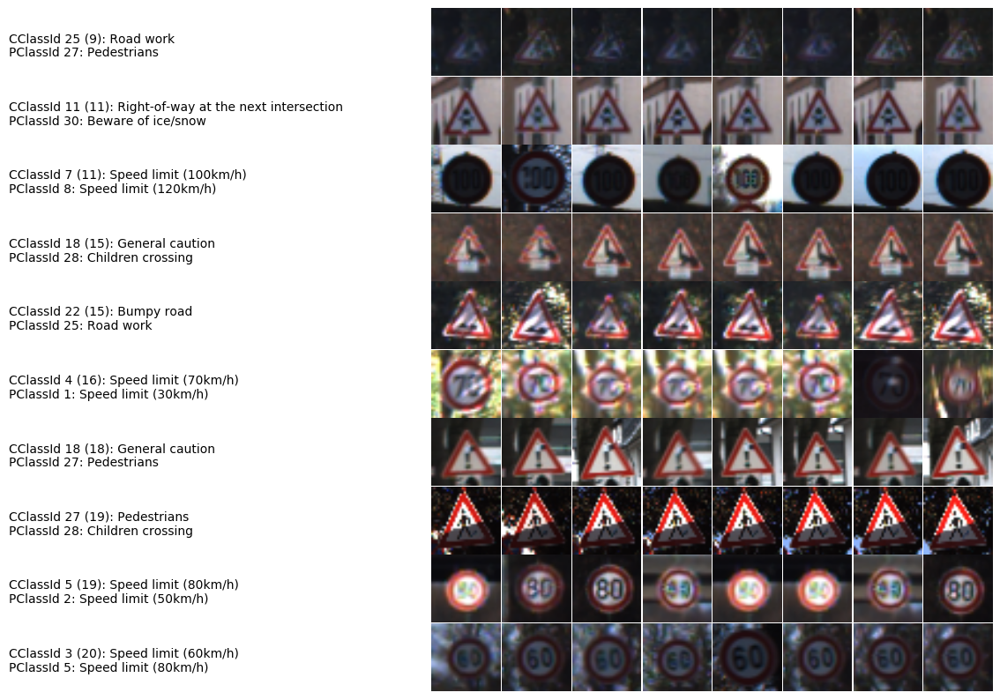

Test set 10 ten incorrect sample images (Y): 100%|██████████| 10/10 [00:03<00:00,  3.47labels/s]


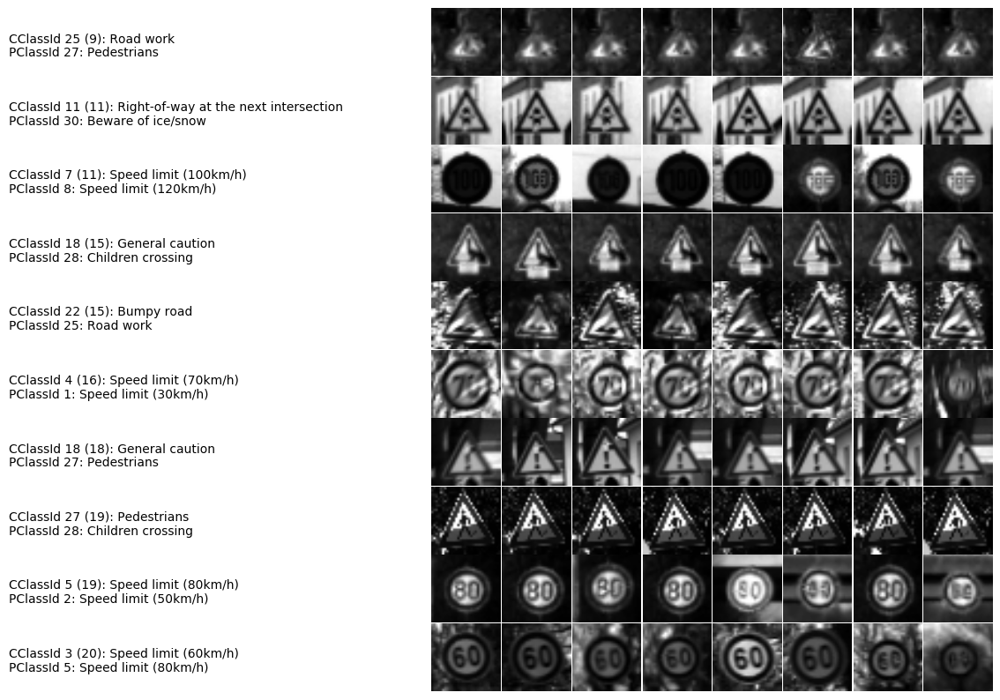

In [58]:
def draw_sample_incorrectmatrix(datasettxt, sortedBuckets, incorrectmatix, dataset, cmap=None):
    n_samples = 8
    n_labels = 10
    
    # size of each sample
    fig = plt.figure(figsize=(n_samples*1.8, n_labels))
    w_ratios = [1 for n in range(n_samples)]
    w_ratios[:0] = [int(n_samples*0.8)]
    h_ratios = [1 for n in range(n_labels)]

    # gridspec
    time.sleep(1) # wait for 1 second for the previous print to appear!
    grid = gridspec.GridSpec(n_labels, n_samples+1, wspace=0.0, hspace=0.0, width_ratios=w_ratios, height_ratios=h_ratios)
    labelset_pbar = tqdm(range(n_labels), desc=datasettxt, unit='labels')
    for a in labelset_pbar:
        cclassId = incorrectmatrix[sortedBuckets[n_labels-a-1]]['correct']
        pclassId = incorrectmatrix[sortedBuckets[n_labels-a-1]]['predicted']
        cdescription = classLabelList[classLabelList.ClassId==cclassId].SignName.to_string(header=False,index=False)
        pdescription = classLabelList[classLabelList.ClassId==pclassId].SignName.to_string(header=False,index=False)
        count = incorrectmatrix[sortedBuckets[n_labels-a-1]]['count']
        for b in range(n_samples+1):
            i = a*(n_samples+1) + b
            ax = plt.Subplot(fig, grid[i])
            if b == 0:
                ax.annotate('CClassId %d (%d): %s\nPClassId %d: %s'%(cclassId, count, cdescription, pclassId, pdescription), xy=(0,0), xytext=(0.0,0.3))
                ax.set_xticks([])
                ax.set_yticks([])
                fig.add_subplot(ax)
            else:
                random_i = random.choice(incorrectmatrix[sortedBuckets[n_labels-a-1]]['samples'])
                image = dataset[random_i]
                if cmap == None:
                    ax.imshow(image)
                else:
                    # yuv = cv2.split(image)
                    # ax.imshow(yuv[0], cmap=cmap)
                    ax.imshow(image, cmap=cmap)
                ax.set_xticks([])
                ax.set_yticks([])
                fig.add_subplot(ax)
    
        # hide the borders\
        if a == (n_labels-1):
            all_axes = fig.get_axes()
            for ax in all_axes:
                for sp in ax.spines.values():
                    sp.set_visible(False)

    plt.show()

draw_sample_incorrectmatrix('Test set 10 ten incorrect sample images (RGB)', sortedBuckets, incorrectmatrix, test['features'])
draw_sample_incorrectmatrix('Test set 10 ten incorrect sample images (Y)', sortedBuckets, incorrectmatrix, X_test, cmap='gray')


### Question 5


_What approach did you take in coming up with a solution to this problem?_

**Answer:**

I first started out by looking at using the MNIST 2 layer convolution model reference here:  https://www.tensorflow.org/versions/r0.11/tutorials/mnist/pros/index.html.  We assumed that this basic model should allow us to get to the 0.98 accuracy without issues; however in practice, we were only able to achieve 0.9632626175880432 testing accuracy using this model.  We will start with their example and use some of the insights gleamed from the yann.lecum.com article to set up our initial architecture. Since we are in a Jupyter interactive session, we will follow the www.tensorflow.com's MNIST PRO tutorial and use an InteractiveSession to access the and build a computation graph as we build our ConvNet for traffic sign classification and recognition.  After building this 2 simple 2 layer convolution model, we were not satisfied with the 0.9633 accuracy score, so we look deeper into the paper by Yann LeCun on their architecture for solving the Traffic Sign Recognition with Multi-Scale Convolution Networks.  The unique features that they had was that the first stage and second stage convolutions of their model fed into a combined classifier.  So, we decided to copy their architecture for our second attempt.

<img src="./model2.png" title="Model2">

We modified our first model and call it stage 1.  Then added additional convolution layers 3 and 4 and call them stage 2.  Stage1 and stage2 output were then sent to a combiner (concat) and then to the fully connected classifier.  We were able to achieve 0.9670630097389221 testing accuracy using this model after exhausting several days of testing, but we were still not satisfied.  So, we went back into the lessons for inspirations and saw the last lesson on the Inception Module.  We hunted for several days on this with no luck, but finally found this article about implementing a Inception Module: https://hackathonprojects.wordpress.com/2016/09/25/inception-modules-explained-and-implemented/, that we discussed in detail in Question 3. We were able to achieve 0.9747 test accuracy score.

<img src="./inception2-model.jpg" title="model3 - final model/architecture">

Still not satisfied, we begin to investigate a 3 inception module model.  This is the same as our third model, but we just add an additional inception module.

<img src="./inception3-model.jpg" title="model4">

At first the model was not converging after numerous attempts with different epochs and learning rates.  My mentor Ashutosh Singh, suggested I post a question in the class forum about a question I had about converging the model.  So, I posted the following question: https://carnd-udacity.atlassian.net/wiki/questions/14287157/want-to-give-inception-modules-a-try.  A fellow student, Malaikannan Sankarasubbu suggested I try a really low learning rate and said that he was able to converge using one, so I decided to try 1e-5 and that started converging.  Thinking that an even lower number would be better, I tried 1e-6, but the model became unresponsive after that so I settled for 5e-6 which made it moved again, but very slowly.  Even after around 300k epochs, its still has not reached passed 0.95 test accuracy yet.  Currently the model is at 0.9435714285714286 testing accuracy, so we decided to abandon this model and go with model 3, the model with 2 inception modules.  Given enough time, we believe the model 4 may actually perform better, but we have spent too long on this project and need to finish it to go on to the next lesson.

Once we decided to stick with model 3, our 2 inception module model, we tried to figure out why we could not move higher than 0.9746 in our test accuracy.  I wrote a function that ran through the test dataset and extracted the errors in the predictions.  The last 3 cells, are the visualization what images the model is having problem predicting correctly.  I thought it strange that the 60km/h incorrect prediction, since it was clearly visible, until I saw this in the training set:

<img src="./60kmInTraining.jpg" title="60km/h training images">

It seems that the 6 in 60 in the test dataset were not in the same font as the one in the training set.  I am not sure if the 2 inception module model will be able to learn this without additional training sample augmentation in the jitter generator.  Looking at the training set distribution, there are more 50 and 30 km/h signs samples then there are 70 and 80 km/h samples. Could it be that the model is predicting on the side of better probability since it sees more samples of those?  This seems to go against having a distribution that matches that of the training set.  The others are definitely sign corruption: the 100km/h sign has a sticker at the 1, or there is something like a G somehow imposed on top of it, the general caution has a sticker at the top or completely mutilated, the pedestrian has a sticker by the right leg, the bumpy road has an uneven shadow against it and the right-of-way at the next intersection has a sticker in the middle.

I was tempted to try and add to the jitter generator to include a random shadow mask and/or a graffiti_and_poster augment, but decided against it since corrupting image data for traffic sign detection needs a bigger discussion.  Plus, I am spending too much time on this project and need to move on, so will settle for the 0.9746 test accuracy score.


---

## Step 3: Test a Model on New Images

Take several pictures of traffic signs that you find on the web or around you (at least five), and run them through your classifier on your computer to produce example results. The classifier might not recognize some local signs but it could prove interesting nonetheless.

You may find `signnames.csv` useful as it contains mappings from the class id (integer) to the actual sign name.

### Implementation

Use the code cell (or multiple code cells, if necessary) to implement the first step of your project. Once you have completed your implementation and are satisfied with the results, be sure to thoroughly answer the questions that follow.

In [68]:
### Load the images and plot them here.
### Feel free to use as many code cells as needed.
###
### Use this cell to create a directory tree for the new images samples.  The directory structure will
### look like this:
### - ./newimages
### - ./newimages/00-Speed limit (20kmph)
### - ./newimages/01-Speed limit (30kmph)
### - ./newimages/02-Speed limit (50kmph)
### - ./newimages/03-Speed limit (60kmph)
### - ./newimages/04-Speed limit (70kmph)
### - ./newimages/05-Speed limit (80kmph)
### - ./newimages/06-End of speed limit (80kmph)
### - ./newimages/07-Speed limit (100kmph)
### - ./newimages/08-Speed limit (120kmph)
### - ./newimages/09-No passing
### - ./newimages/10-No passing for vechiles over 3.5 metric tons
### - ./newimages/11-Right-of-way at the next intersection
### - ./newimages/12-Priority road
### - ./newimages/13-Yield
### - ./newimages/14-Stop
### - ./newimages/15-No vechiles
### - ./newimages/16-Vechiles over 3.5 metric tons prohibited
### - ./newimages/17-No entry
### - ./newimages/18-General caution
### - ./newimages/19-Dangerous curve to the left
### - ./newimages/20-Dangerous curve to the right
### - ./newimages/21-Double curve
### - ./newimages/22-Bumpy road
### - ./newimages/23-Slippery road
### - ./newimages/24-Road narrows on the right
### - ./newimages/25-Road work
### - ./newimages/26-Traffic signals
### - ./newimages/27-Pedestrians
### - ./newimages/28-Children crossing
### - ./newimages/29-Bicycles crossing
### - ./newimages/30-Beware of ice/snow
### - ./newimages/31-Wild animals crossing
### - ./newimages/32-End of all speed and passing limits
### - ./newimages/33-Turn right ahead
### - ./newimages/34-Turn left ahead
### - ./newimages/35-Ahead only
### - ./newimages/36-Go straight or right
### - ./newimages/37-Go straight or left
### - ./newimages/38-Keep right
### - ./newimages/39-Keep left
### - ./newimages/40-Roundabout mandatory
### - ./newimages/41-End of no passing
### - ./newimages/42-End of no passing by vechiles over 3.5 metric ...

directorybase = "./newimages"
if not os.path.exists(directorybase):
    os.makedirs(directorybase)
    
for i in range(n_labels):
    description = classLabelList[classLabelList.ClassId==i].SignName.to_string(header=False,index=False)
    description = description.replace("/", "p")
    directory = "{0:s}/{1:02d}-{2:s}".format(directorybase,i,description)
    if not os.path.exists(directory):
        os.makedirs(directory)

print("New image directories created.")

New image directories created.


Your ./newimage directory structure should look something like this now:
<img src="./new-image-directories.png" title="New Image directories">

appending:  {'label': 38, 'count': 1, 'samples': [0]}
appending:  {'label': 14, 'count': 2, 'samples': [1, 2]}
appending:  {'label': 27, 'count': 1, 'samples': [3]}
appending:  {'label': 17, 'count': 1, 'samples': [4]}


New samples (RGB): 100%|██████████| 4/4 [00:01<00:00,  2.93labels/s]


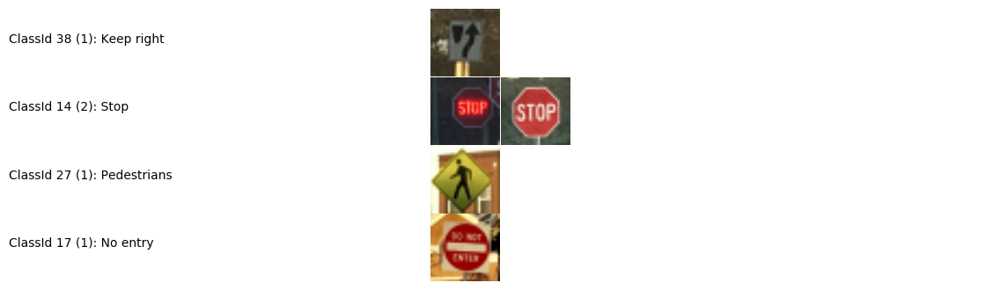

New samples (Normalized Y): 100%|██████████| 4/4 [00:01<00:00,  2.75labels/s]


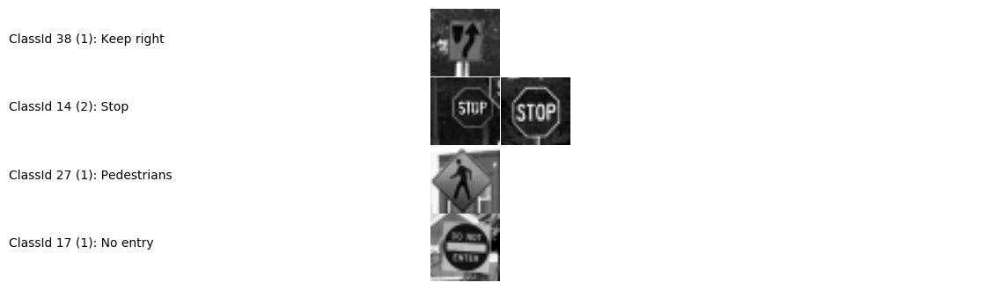

done


In [50]:
### Load the images and plot them here.
### Feel free to use as many code cells as needed.
###
### Now place the new images in to their correct labeled subdirectories under ./newimages that
### correspond to their classification.  The images can be any size, but should be cropped to just
### the traffic  sign using a utility outside of this cell - like gimp in Linux or Preview in OSX.
### The input pipeline will automatically load the images into memory, label them appropriately based
### on the subdirectory they were placed in and resize them to the required size image (32x32) and
### then preprocess them for prediction from the Model 2 - 2 inception module model that is our final
### model.  The preprocessing steps are as follows:
###
### 1. Convert the images to YUV
### 2. Normalize the Y (luma) in the YUV image and remove the UV, chroma from our sample
### 3. Convert the unsigned 8-bit Y (luma) value to a 32-bit floating point number for GPU processing.
### 4. Convert our 43 labels to One-Hot encoding
### 5. Convert the One-Hot encoded integer value to 32-bit floating point number for GPU processing.
###
### Once you have loaded the images you want to predict, run this cell to display the image
### class distributions and samples.
###

def draw_sample_newimage_labels(datasettxt, labeldata, dataset, cmap=None):
    n_maxsamples = 8
    n_labels = len(labeldata)
    
    # size of each sample
    fig = plt.figure(figsize=(n_maxsamples*1.8, n_labels))
    w_ratios = [1 for n in range(n_maxsamples)]
    w_ratios[:0] = [int(n_maxsamples*0.8)]
    h_ratios = [1 for n in range(n_labels)]

    # gridspec
    time.sleep(1) # wait for 1 second for the previous print to appear!
    grid = gridspec.GridSpec(n_labels, n_maxsamples+1, wspace=0.0, hspace=0.0, width_ratios=w_ratios, height_ratios=h_ratios)
    labelset_pbar = tqdm(range(n_labels), desc=datasettxt, unit='labels')
    for a in labelset_pbar:
        classId = labeldata[a]['label']
        description = classLabelList[classLabelList.ClassId==classId].SignName.to_string(header=False,index=False)
        count = labeldata[a]['count']
        for b in range(n_maxsamples+1):
            i = a*(n_maxsamples+1) + b
            ax = plt.Subplot(fig, grid[i])
            if b == 0:
                ax.annotate('ClassId %d (%d): %s'%(classId, count, description), xy=(0,0), xytext=(0.0,0.5))
                ax.set_xticks([])
                ax.set_yticks([])
                fig.add_subplot(ax)
            else:
                if (b-1) < len(labeldata[a]['samples']):
                    image = dataset[labeldata[a]['samples'][b-1]]
                    if cmap == None:
                        ax.imshow(image)
                    else:
                        # yuv = cv2.split(image)
                        # ax.imshow(yuv[0], cmap=cmap)
                        ax.imshow(image, cmap=cmap)
                ax.set_xticks([])
                ax.set_yticks([])
                fig.add_subplot(ax)
    
        # hide the borders\
        if a == (n_labels-1):
            all_axes = fig.get_axes()
            for ax in all_axes:
                for sp in ax.spines.values():
                    sp.set_visible(False)

    plt.show()

newimages = []
newlabels = []
new_onehot = []
newlabelsdata = []
directories = "./newimages"
subdirs = os.listdir(directories)
for subdir in subdirs:
    classId = int(subdir.split("-")[0])
    classinfo = {'label':classId,'count':0, 'samples':[]}
    filepath = directories+"/"+subdir
    for filename in os.listdir(filepath):
        image_filepath = filepath+"/"+filename
        image = mpimg.imread(image_filepath)
        image = cv2.resize(image, (32, 32), interpolation=cv2.INTER_AREA)
        newimages.append(image)
        newlabels.append(classId)
        new_onehot.append(onehot_labels[classId])
        classinfo['count'] += 1
        classinfo['samples'].append(len(newimages)-1)
    if classinfo['count'] > 0:
        print("appending: ", classinfo)
        newlabelsdata.append(classinfo)

newimages = np.array(newimages)
newlabels = np.array(newlabels)
new_onehot = np.array(new_onehot)

draw_sample_newimage_labels("New samples (RGB)", newlabelsdata, newimages)
X_new = normalize_Y(RGB2YUV(newimages))
draw_sample_newimage_labels("New samples (Normalized Y)", newlabelsdata, X_new, cmap='gray')

if len(X_new) > 0:
    empty_image_filler = [np.copy(X_new[0])]
    empty_onehot_filler = [np.copy(new_onehot[0])]


print("done")

### Question 6

_Choose five candidate images of traffic signs and provide them in the report. Are there any particular qualities of the image(s) that might make classification difficult? It would be helpful to plot the images in the notebook._



**Answer:**

We designed the system to automatically generate the labels and the next step will be to make a prediction/recognition attempt on all of them.  We believe with the current training, the our final model may not be able to predict any of the signs except for perhaps the Stop sign.  These are the following logic for our reasoning:

1. Keep right sign for the US is a different shape than that in Germany (Rectangular instead of round).
2. Keep right sign has a different symbol in the US than that in Germany (Curved arrow to the right instead of straight arrow down and to the right).
3. Pedestrians crossing sign is a different shape than that in Germany (Diamond instead of Triangle).
4. No Entry sign for the US has words written on the top and bottom of red circle, where as in the German sign, no words are shown.

All images are plotted above in both RGB (color) and in Normalized Y (Luma/Gray Scale).

Model initialized.
Model restored.

Number of unique buckets in incorrect set:  4 

Mode Bucket:  14+14 with count:  2

Distribution of buckets with predicted test dataset labels:
incorrect set count:    2  CClassId: 14 Description: Stop
                           PClassId: 14 Description: Stop
incorrect set count:    1  CClassId: 17 Description: No entry
                           PClassId: 16 Description: Vechiles over 3.5 metric tons prohibited
incorrect set count:    1  CClassId: 27 Description: Pedestrians
                           PClassId: 12 Description: Priority road
incorrect set count:    1  CClassId: 38 Description: Keep right
                           PClassId: 13 Description: Yield


prediction images (RGB): 100%|██████████| 4/4 [00:01<00:00,  3.26labels/s]


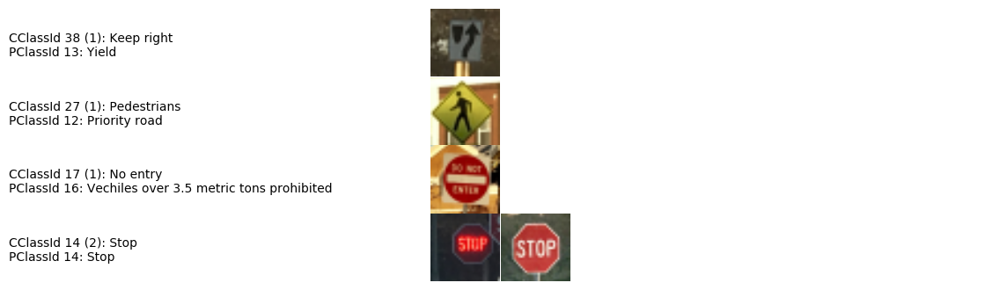

prediction sample images (Y): 100%|██████████| 4/4 [00:01<00:00,  3.68labels/s]


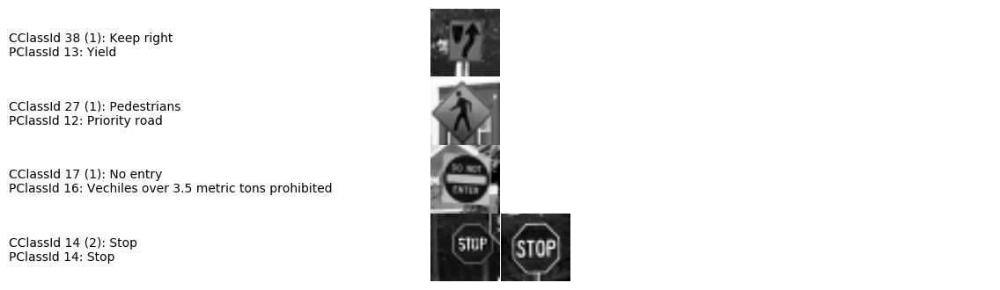

In [52]:
### Run the predictions here.
### Feel free to use as many code cells as needed.

# code to gather and display samples that the final model predicts for traffic sign recognition.
def correctness(target,predictions):
    return np.argmax(target,0) == np.argmax(predictions,0)

def draw_sample_correctmatrix(datasettxt, sortedBuckets, incorrectmatix, dataset, cmap=None):
    n_maxsamples = 8
    n_labels = len(sortedBuckets)
    
    # size of each sample
    fig = plt.figure(figsize=(n_maxsamples*1.8, n_labels))
    w_ratios = [1 for n in range(n_maxsamples)]
    w_ratios[:0] = [int(n_maxsamples*0.8)]
    h_ratios = [1 for n in range(n_labels)]

    # gridspec
    time.sleep(1) # wait for 1 second for the previous print to appear!
    grid = gridspec.GridSpec(n_labels, n_maxsamples+1, wspace=0.0, hspace=0.0, width_ratios=w_ratios, height_ratios=h_ratios)
    labelset_pbar = tqdm(range(n_labels), desc=datasettxt, unit='labels')
    for a in labelset_pbar:
        cclassId = incorrectmatrix[sortedBuckets[n_labels-a-1]]['correct']
        pclassId = incorrectmatrix[sortedBuckets[n_labels-a-1]]['predicted']
        cdescription = classLabelList[classLabelList.ClassId==cclassId].SignName.to_string(header=False,index=False)
        pdescription = classLabelList[classLabelList.ClassId==pclassId].SignName.to_string(header=False,index=False)
        count = incorrectmatrix[sortedBuckets[n_labels-a-1]]['count']
        for b in range(n_maxsamples+1):
            i = a*(n_maxsamples+1) + b
            ax = plt.Subplot(fig, grid[i])
            if b == 0:
                ax.annotate('CClassId %d (%d): %s\nPClassId %d: %s'%(cclassId, count, cdescription, pclassId, pdescription), xy=(0,0), xytext=(0.0,0.3))
                ax.set_xticks([])
                ax.set_yticks([])
                fig.add_subplot(ax)
            else:
                if (b-1) < count:
                    image = dataset[incorrectmatrix[sortedBuckets[n_labels-a-1]]['samples'][b-1]]
                    if cmap == None:
                        ax.imshow(image)
                    else:
                        # yuv = cv2.split(image)
                        # ax.imshow(yuv[0], cmap=cmap)
                        ax.imshow(image, cmap=cmap)
                ax.set_xticks([])
                ax.set_yticks([])
                fig.add_subplot(ax)
    
        # hide the borders\
        if a == (n_labels-1):
            all_axes = fig.get_axes()
            for ax in all_axes:
                for sp in ax.spines.values():
                    sp.set_visible(False)

    plt.show()

sess = tf.Session(graph=graphv3)
 
#initialize variables
sess.run(init)
print("Model initialized.")
 
#set use_previous=1 to use file_path model
#set use_previous=0 to start model from scratch
use_previous = 1
 
#use the previous model or don't and initialize variables
if use_previous:
    saver.restore(sess,filev3_path)
    print("Model restored.")
 
result = np.array([]).reshape(0,43)

# initialize 
X_new_size = len(X_new)
X_remainder = X_new_size%test_batch_size
if X_remainder > 0:
    for i in range(test_batch_size-X_remainder):
        new_onehot = np.append(new_onehot, empty_onehot_filler, axis=0)
        X_new = np.append(X_new, empty_image_filler, axis=0)
        
for i in range(int(len(X_new)/test_batch_size)):
    start = i*test_batch_size
    batch_testX = X_new[start:start+test_batch_size]
    feed_dict = {tf_testX : batch_testX.reshape([-1,32,32,1])}
    preds=sess.run(predictions_test, feed_dict=feed_dict)
    result=np.concatenate((result,preds),axis=0)

X_new = X_new[0:X_new_size]
y_new_onehot = new_onehot[0:X_new_size]  
result = result[0:X_new_size]

incorrectlist = []
for i in range(len(y_new_onehot)):
    correct_classId = np.argmax(y_new_onehot[i],0)
    predict_classId = np.argmax(result[i],0)
    incorrectlist.append({'index':i, 'correct':correct_classId, 'predicted':predict_classId})
sess.close()
incorrectmatrix = {}
modeCount = 0
for i in range(len(incorrectlist)):
    predicted = incorrectlist[i]['predicted']
    correct = incorrectlist[i]['correct']
    index = incorrectlist[i]['index']
    bucket = str(correct)+"+"+str(predicted)
    incorrectinstance = incorrectmatrix.get(bucket, {'count': 0, 'samples':[]})
                                                     
    # add to the count
    count = incorrectinstance['count'] + 1
    
    # add to samples of this correct to predicted condition
    samples = incorrectinstance['samples']
    samples.append(index)
    
    # put back in the list
    incorrectmatrix[bucket] = {'count': count, 'correct':correct, 'predicted':predicted, 'samples':samples}
    
    # update most common error
    if count > modeCount:
        modeCount = count
        modeBucket = bucket
    
# get the list of buckets and sort them
def compare_bucket_count(bucket):
    return modeCount-incorrectmatrix[bucket]['count']

sortedBuckets = list(incorrectmatrix.keys())
sortedBuckets.sort(key=compare_bucket_count)

# get the unique number of original picture sizes and the min and max last instance
n_buckets = len(sortedBuckets)

# print the stats
print("\nNumber of unique buckets in incorrect set: ", n_buckets, "\n")
print("Mode Bucket: ", modeBucket, "with count: ", modeCount)

print("\nDistribution of buckets with predicted test dataset labels:")
for n in range(len(sortedBuckets)):
    bucket = sortedBuckets[n]
    cclassId = incorrectmatrix[bucket]['correct']
    pclassId = incorrectmatrix[bucket]['predicted']
    count = incorrectmatrix[bucket]['count']
    cdescription = classLabelList[classLabelList.ClassId==cclassId].SignName.to_string(header=False,index=False)
    pdescription = classLabelList[classLabelList.ClassId==pclassId].SignName.to_string(header=False,index=False)
    print("incorrect set count: {0:4d}  CClassId: {1:02d} Description: {2}\n                           PClassId: {3:02d} Description: {4}".format(count, cclassId, cdescription, pclassId, pdescription))

draw_sample_correctmatrix('prediction images (RGB)', sortedBuckets, incorrectmatrix, newimages)
draw_sample_correctmatrix('prediction sample images (Y)', sortedBuckets, incorrectmatrix, X_new, cmap='gray')


### Question 7

_Is your model able to perform equally well on captured pictures or a live camera stream when compared to testing on the dataset?_


**Answer:**

We are glad that the US Stop signs were recognized by the trained model and as predicted, the other US traffic signs were not.  Our test accuracy for the US traffic sign sample was 2 out of 5 or 2/5 = 0.4 testing accuracy as compared to the test accuracy of the German traffic signs: 0.9747.

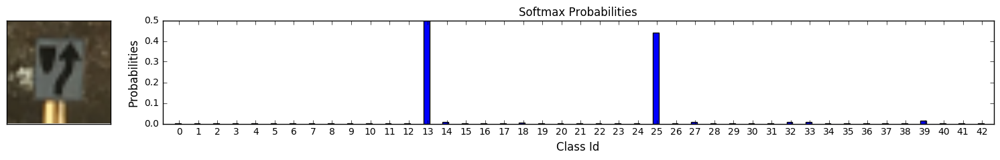

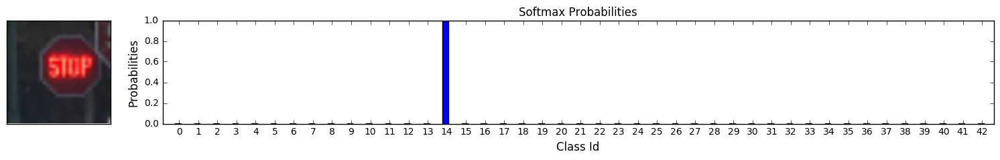

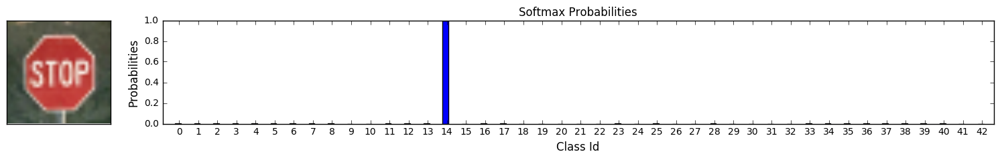

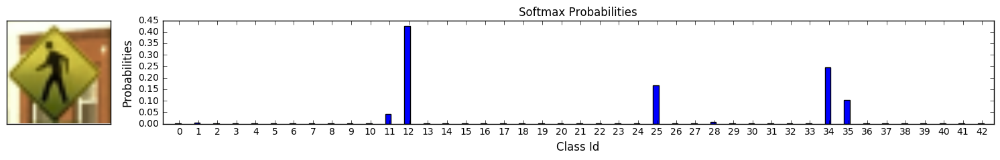

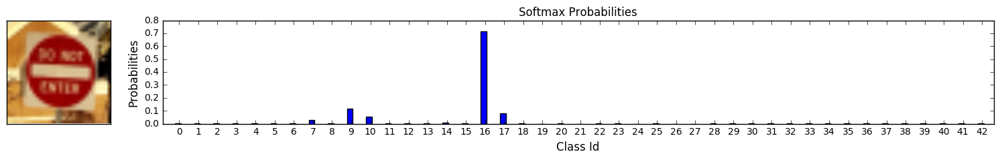

In [126]:
### Visualize the softmax probabilities here.
### Feel free to use as many code cells as needed.


# Plot bar graph of softmax probabilities
n_labels = 43
newlabels = []
for i in range(n_labels):
    newlabels.append(i)

ind = np.arange(n_labels)
width = 0.35

w_ratios = [2, 8]
h_ratios = [2]

# gridspec
for a in range(len(newimages)):
    # size of each sample
    fig = plt.figure(figsize=(20, 2))
    grid = gridspec.GridSpec(1, 2, wspace=0.0, hspace=0.0, width_ratios=w_ratios, height_ratios=h_ratios)
    for b in range(2):
        ax = plt.Subplot(fig, grid[b])
        if b == 0:
            image = newimages[a]
            ax.imshow(image)
            ax.set_xticks([])
            ax.set_yticks([])
            fig.add_subplot(ax)
        else:
            # fg, ax = plt.subplots(figsize=(n_labels/3, 3))
            p1 = ax.bar(ind*1.15+0.75, result[a], width, color='b')

            # add some text for labels, title and axes ticks
            ax.set_ylabel("Probabilities", fontsize=12)
            ax.set_title("Softmax Probabilities", fontsize=12)
            ax.set_xticks(ind*1.15 + 1.0)
            ax.set_xticklabels(newlabels, fontsize=10)
            ax.set_xlabel("Class Id", fontsize=12)
            fig.add_subplot(ax, figsize=(n_labels/3, 3))
    
    # hide the borders\
    if a == (n_labels-1):
        all_axes = fig.get_axes()
        for ax in all_axes:
            for sp in ax.spines.values():
                sp.set_visible(False)
    plt.show()


### Question 8

*Use the model's softmax probabilities to visualize the **certainty** of its predictions, [`tf.nn.top_k`](https://www.tensorflow.org/versions/r0.11/api_docs/python/nn.html#top_k) could prove helpful here. Which predictions is the model certain of? Uncertain? If the model was incorrect in its initial prediction, does the correct prediction appear in the top k? (k should be 5 at most)*


**Answer:**

For the US traffic signs, our model was only 100% certain for the Stop signs (classId 14), which seems to confirm our initial assumption from our answer to question 6 above.  For the other given new US traffic signs samples, our 2 inception modules model were less certain of, as can be seen by the bar charts above next to their prespective images the model were given to predict, recognize, and classify.  We find the following probabilities for each of the US traffic signs:

1. US traffic Keep Right Sign: The two main German traffic sign contenders were classId 13 - Yield, coming in at 50% and classId 25 - Road work, coming in at 45% probabilities.  The other German signs were too low to be considered in the running by our model.
2. US traffic Stop Sign: Our model were able to predict these 100% of the time with 100% certainty.  This makes sense because the US traffic Stop sign and the German traffic Stop sign are identical.
3. US traffic Pedestrians Sign: Our model were not able to make a prediction on this sign with more than 50% probabilities.  Our model's top five main German traffic sign contenters in order are:
    - a. 12 - German Priority road (~44%)
    - b. 34 - German Turn left ahead (~25%)
    - c. 25 - Road Work (~17%)
    - d. 35 - Ahead only (~11%)
    - e. 11 - Right-of-way at the next intersection (~5%)
4. US traffic No Entry (DO NOT Enter) sign: Our model really only have one main German traffic sign contender: 16 - Vechiles over 3.5 metric tons prohibited with more than 70% probabilities for the model.  The others have probabilities under 20% and should not even be considered for the top 5.

This verifies our original hypothesis in answer to question 6, that our model would only predict the US traffic Stop sign correctly with the model trained on German traffic sign recognition.

### Question 9
_If necessary, provide documentation for how an interface was built for your model to load and classify newly-acquired images._


**Answer:**

We believe our interface has been documented in-line in this section 3.  If there are any issues with the in-line documentation, please let us know.  If a stand-alone version of the interface is required, we can discuss how it can be done with the current trained session save files.  Please Note: the current model's session save files are over 2GB in size for the 2 inception modules model and over 4GB in size for the 3 inception modules model.

> **Note**: Once you have completed all of the code implementations and successfully answered each question above, you may finalize your work by exporting the iPython Notebook as an HTML document. You can do this by using the menu above and navigating to  \n",
    "**File -> Download as -> HTML (.html)**. Include the finished document along with this notebook as your submission.